# Method experiment 

In [1]:
from function import *

Using TensorFlow backend.


In [2]:
# Definition of the path of the data
data_path = 'C:\\Users\\pierr\\Desktop\\Projet de semestre I\\data\\task_2\\train_set\\discontinuity_0_1\\mesh_B\\data_set_p_3_all.csv'

In [97]:
# load the data 
data = np.loadtxt(data_path, delimiter=',')
ind = data[:,0]
point_inter = data[:,1:3]
data_nn = data[:,3:-1]
true_angle = data[:,-1]
print(data.shape)
print(data_nn.shape)
print(point_inter.shape)
print(true_angle.shape)

(11639, 46)
(11639, 42)
(11639, 2)
(11639,)


In [98]:
X_train , X_test , Y_train , Y_test, permuted_indice_train , permuted_indice_test = data_preparation(data_nn)

In [99]:
# check the size of the vector 
print(X_train.shape)
print(Y_train.shape)
print(X_test.shape)
print(Y_test.shape)

(9311, 40)
(9311, 2)
(2328, 40)
(2328, 2)


In [100]:
model_1 = build_model_40()

Epoch 00412: early stopping
MSE angle test: 0.077
MSE 2 angle test: 0.030
MSE Train: 0.008 | MSE Test: 0.009


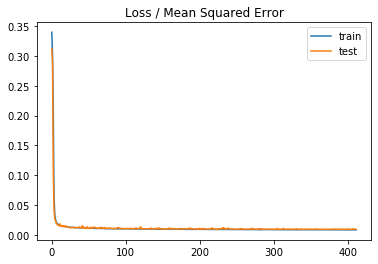

In [101]:
train_mse,test_mse = model_training(model_1,X_train,X_test,Y_train,Y_test, patience_ = 50 , plot=True )

In [9]:
def visualisation_plot(indice , true_angle , point_inter , model , X_test , Y_test ,permuted_indice_test ):
    indice_in_data = permuted_indice_test[indice]
    x = X_test[indice]
    y = Y_test[indice]
    point = point_inter[indice_in_data]
    angle = true_angle[indice_in_data]
    
    direction = np.array([ np.cos(angle) ,np.sin(angle) ])
    y_pred = model.predict(x , verbose = 0)
    
    VA = - np.ones((2))
    pts = np.array([[-1,-1],[-1,1],[1,-1]])
    lam = np.linspace(3,-3,1000)
    interpolate_space = np.linspace(-1,1,4)
    interpolate_space_flip = np.flip(interpolate_space)
    interpolate_point = np.ones((2,10))
    p=0
    for i in range(4):
        for j in range(i+1):
            interpolate_point[0,p]=interpolate_space_flip[i]
            interpolate_point[1,p]=interpolate_space[j]
            p +=1 
    
    plt.figure(figsize=(8,8))
    triangle = plt.Polygon(pts,fill=False)
    plt.gca().add_patch(triangle)
    plt.scatter(interpolate_point[0,:],interpolate_point[1,:])
    plt.plot(point[0,0] + lam*direction[0,0] ,point[0,1] + lam*direction[1,0] , label=' Discontinuity' )
    plt.arrow(-1,-1,y[0,0],y[0,1],color='g' ,label = ' true orthogonal vector')
    plt.arrow(-1 ,-1 , y_pred[0,0] , y_pred[0,1],color='r'  , label = ' predict orthogonal vector ')
    plt.xlim(-2,2)
    plt.ylim(-2,2)
    plt.legend()
    plt.show()
    

In [11]:
def visualisation_plot_3(indice , true_angle , point_inter , model , X_test , Y_test ,permuted_indice_test ):
    indice_in_data = permuted_indice_test[indice]
    x = X_test[indice]
    y = Y_test[indice]
    point = point_inter[indice_in_data]
    angle = true_angle[indice_in_data]
    
    direction = np.array([ np.cos(angle) ,np.sin(angle) ])
    y_pred = model.predict(x , verbose = 0)
    
    VA = - np.ones((2))
    pts = np.array([[-1,-1],[-1,1],[1,-1]])
    lam = np.linspace(3,-3,1000)
    interpolate_space = np.linspace(-1,1,4)
    interpolate_space_flip = np.flip(interpolate_space)
    interpolate_point = np.ones((2,10))
    p=0
    for i in range(4):
        for j in range(i+1):
            interpolate_point[0,p]=interpolate_space_flip[i]
            interpolate_point[1,p]=interpolate_space[j]
            p +=1
    
    plt.figure(figsize=(8,8))
    triangle = plt.Polygon(pts,fill=False)
    plt.gca().add_patch(triangle)
    plt.scatter(interpolate_point[0,:],interpolate_point[1,:])
    plt.plot(point[0,0] + lam*direction[0,0] ,point[0,1] + lam*direction[1,0] , label=' Discontinuity' )
    plt.arrow(-1,-1,y[0,0]*y[0,2],y[0,1]*y[0,2],color='g' ,label = ' true orthogonal vector')
    plt.arrow(-1 ,-1 , y_pred[0,0]*y_pred[0,2] , y_pred[0,1]*y_pred[0,2] ,color='r'  , label = ' predict orthogonal vector ')
    plt.xlim(-2,2)
    plt.ylim(-2,2)
    plt.legend()
    plt.show()

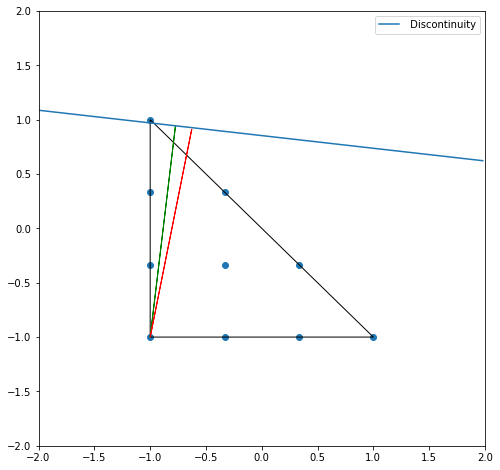

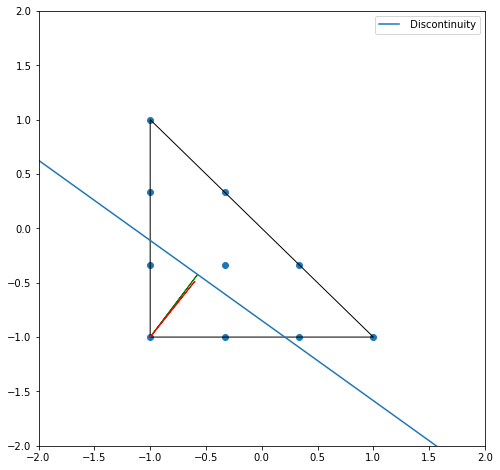

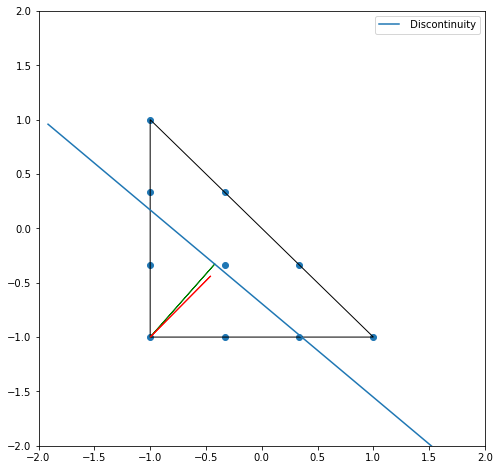

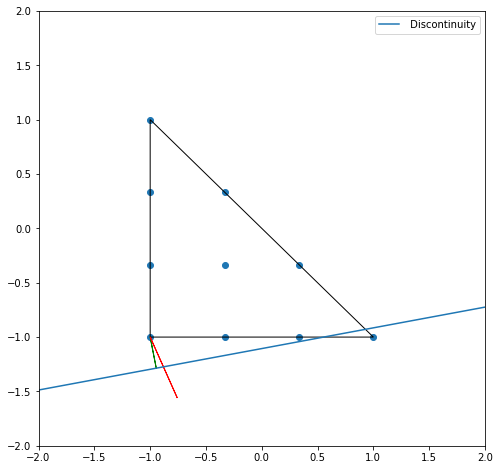

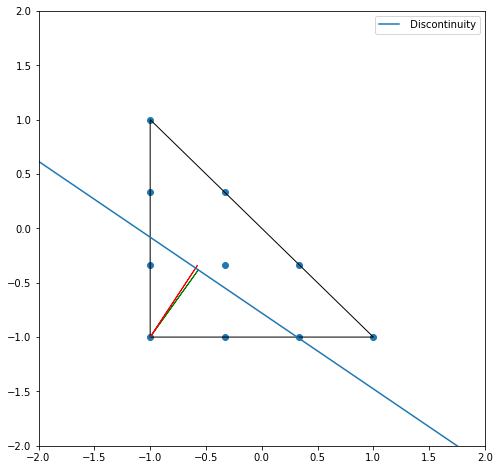

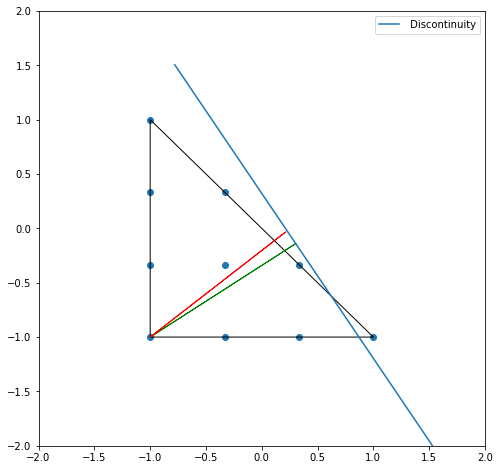

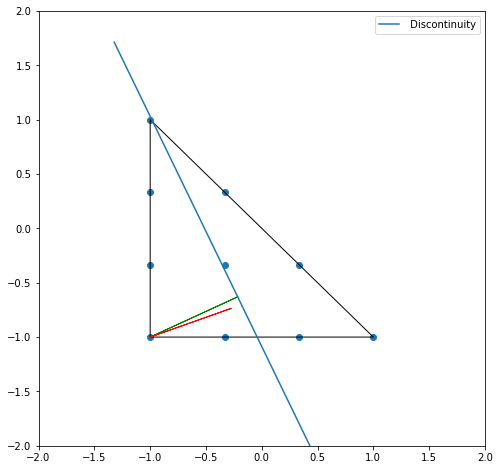

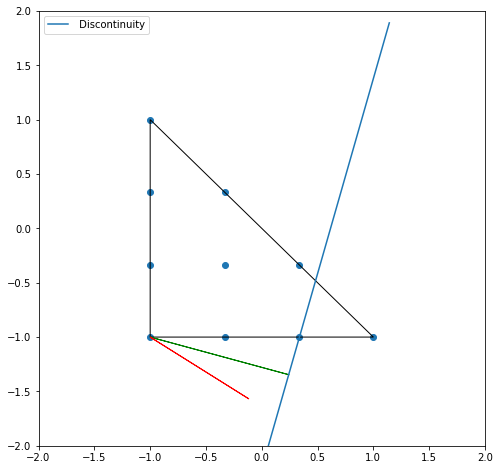

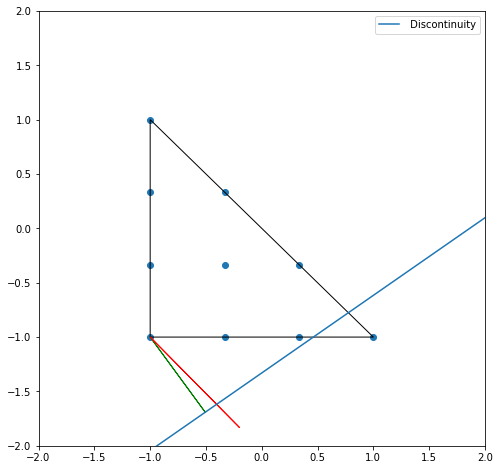

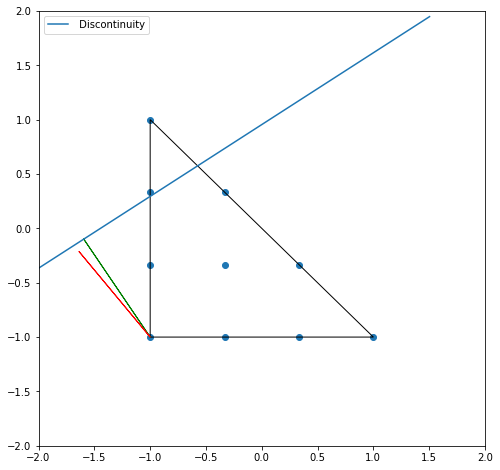

In [107]:
for i in range(10):
    visualisation_plot( [i] , true_angle , point_inter , model_1 , X_test , Y_test ,permuted_indice_test)

In [46]:
Y_pred = model.predict(X_test , verbose = 0 )
true_angle_ = np.arctan2(Y_test[:,0] ,Y_test[:,1])
pred_angle = np.arctan2(Y_pred[:,0 ] ,Y_pred[:,1] )
error = true_angle_ - pred_angle
indice_error = np.where(error>0.5)[0]

In [47]:
error = true_angle_ - pred_angle

In [50]:
indice_error = np.where(error>0.5)[0]

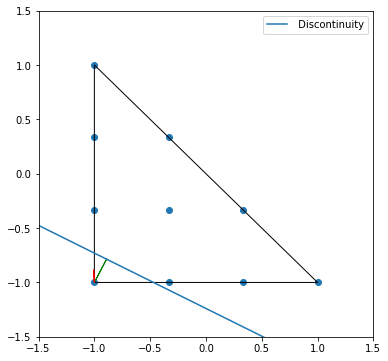

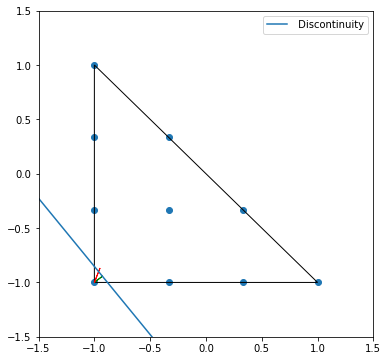

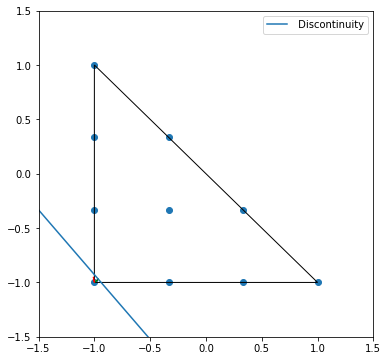

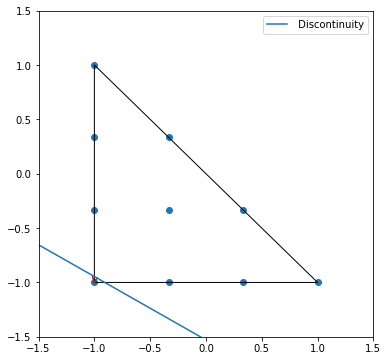

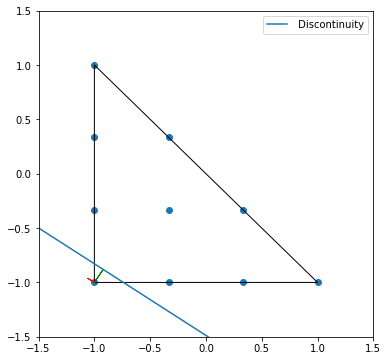

...

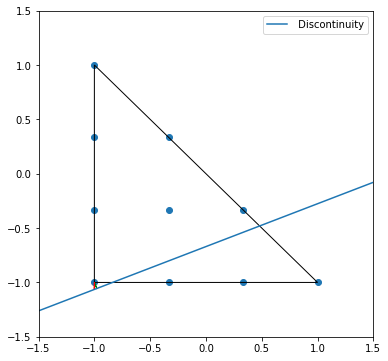

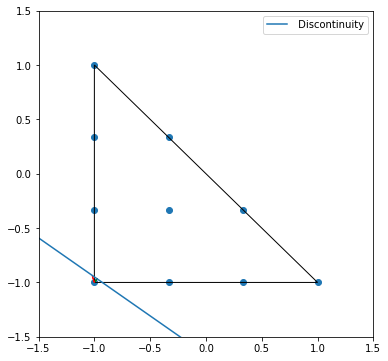

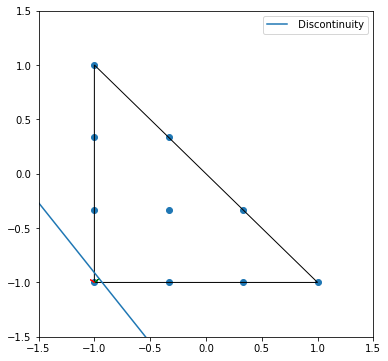

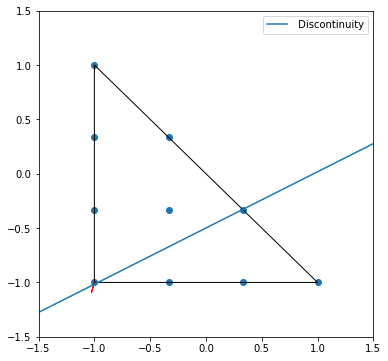

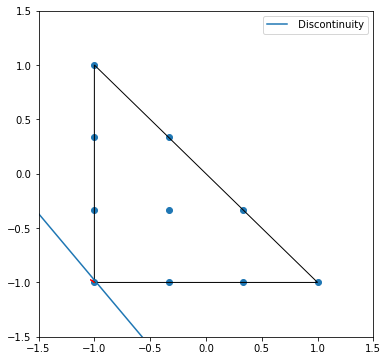

In [51]:
for ind in indice_error :
    visualisation_plot( [ind] , true_angle , point_inter , model , X_test , Y_test ,permuted_indice_test)

In [27]:
# load the data 
data = np.loadtxt(data_path, delimiter=',')
ind = data[:,0]
point_inter = data[:,1:3]
data_nn = data[:,3:-1]
true_angle = data[:,-1]
print(data.shape)
print(data_nn.shape)
print(point_inter.shape)
print(true_angle.shape)

(47395, 46)
(47395, 42)
(47395, 2)
(47395,)


In [28]:
vecteur_norm = np.linalg.norm(data_nn[:,-2:],axis=1)
divide =  np.c_[vecteur_norm ,vecteur_norm ]
data_nn[:,-2:] /= divide
data_nn = np.c_[data_nn ,vecteur_norm ]
print(data_nn.shape)

(47395, 43)


In [29]:
X_train , X_test , Y_train , Y_test, permuted_indice_train , permuted_indice_test = data_preparation(data_nn)
# check the size of the vector 
print(X_train.shape)
print(Y_train.shape)
print(X_test.shape)
print(Y_test.shape)

(37916, 40)
(37916, 3)
(9479, 40)
(9479, 3)


In [30]:
model_1 = build_model_40()

Epoch 00414: early stopping
MSE angle test: 0.007
MSE 2 angle test: 0.007
MSE Train: 0.006 | MSE Test: 0.006


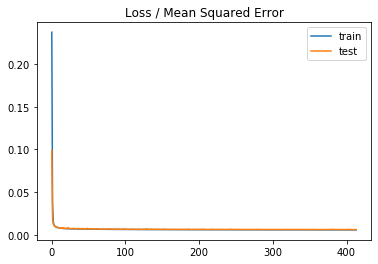

In [31]:
train_mse,test_mse = model_training(model_1,X_train,X_test,Y_train,Y_test, patience_ = 50 , plot=True )

In [33]:
Y_pred = model_1.predict(X_test , verbose = 0 )
true_angle_ = np.arctan2(Y_test[:,0] ,Y_test[:,1])
pred_angle = np.arctan2(Y_pred[:,0 ] ,Y_pred[:,1] )
error = true_angle_ - pred_angle
indice_error = np.where(error>0.1)[0]
print(len(indice_error)/len(error)*100)


9.2836797130499


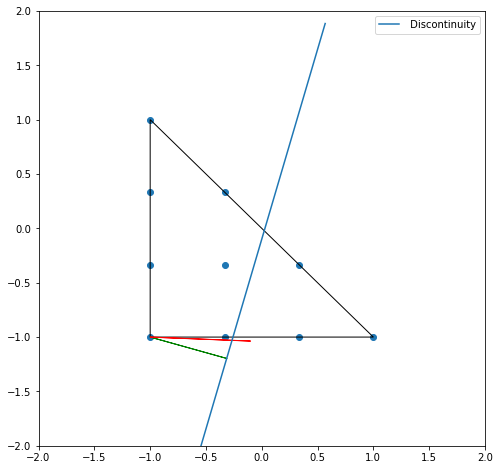

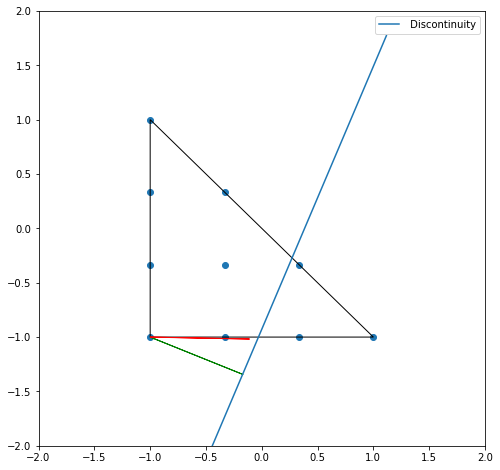

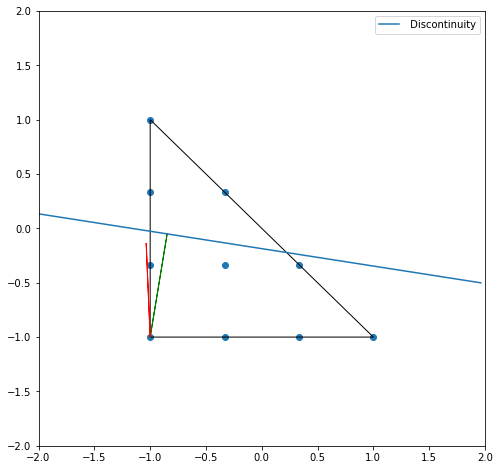

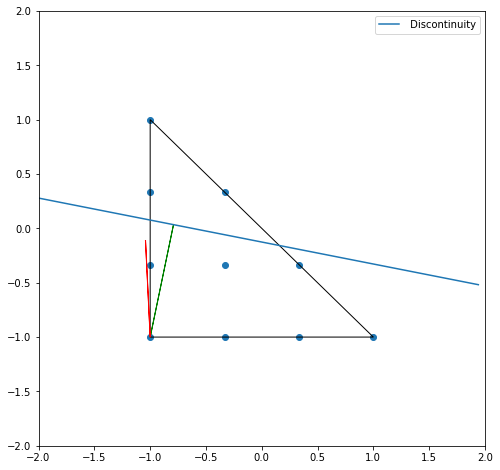

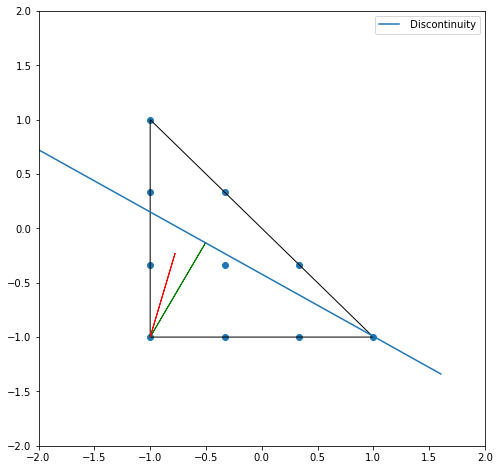

...

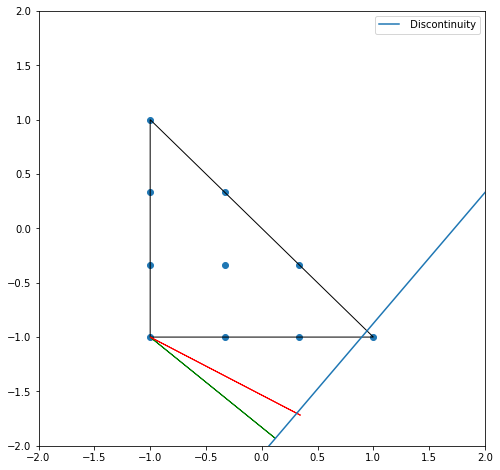

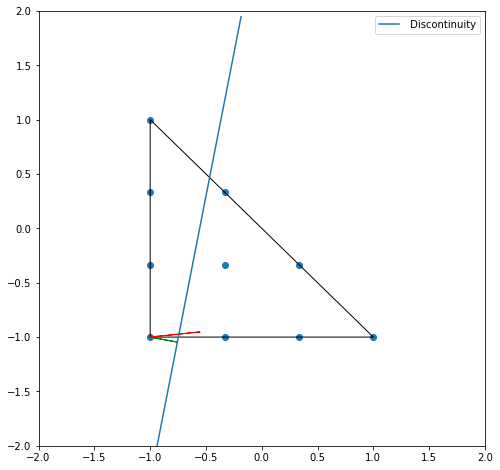

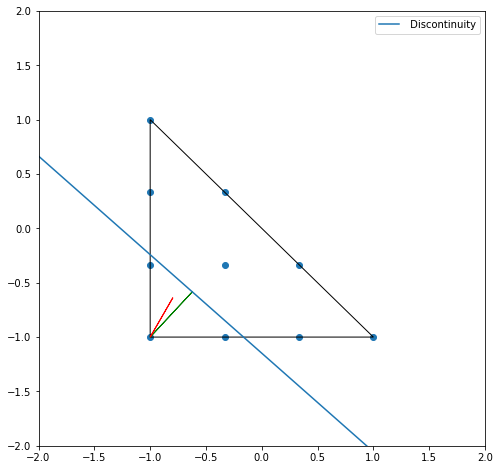

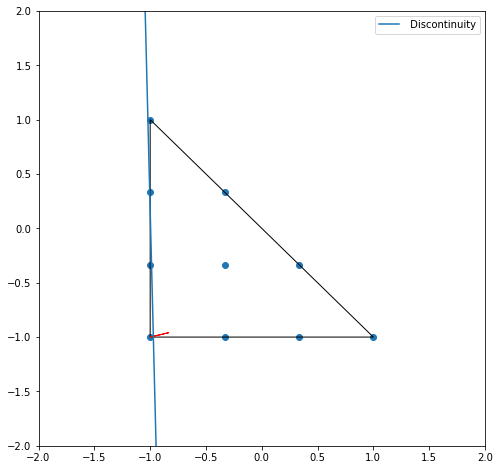

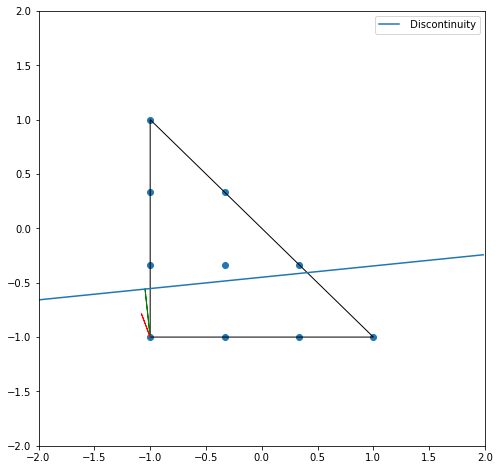

In [26]:
for ind in indice_error :
    visualisation_plot_3( [ind] , true_angle , point_inter , model_1 , X_test , Y_test ,permuted_indice_test)

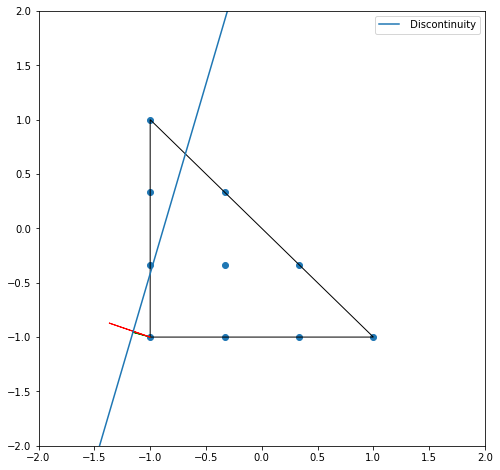

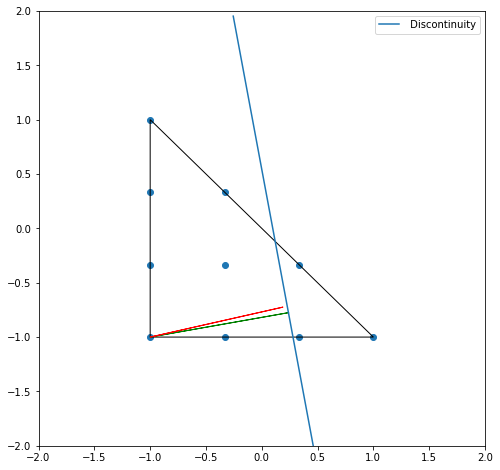

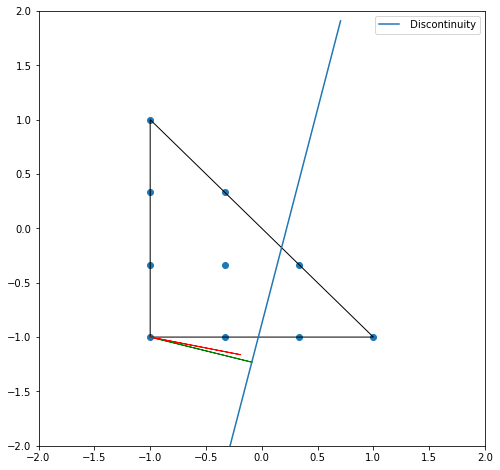

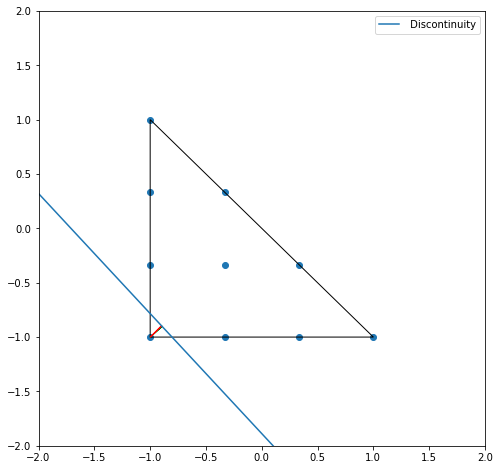

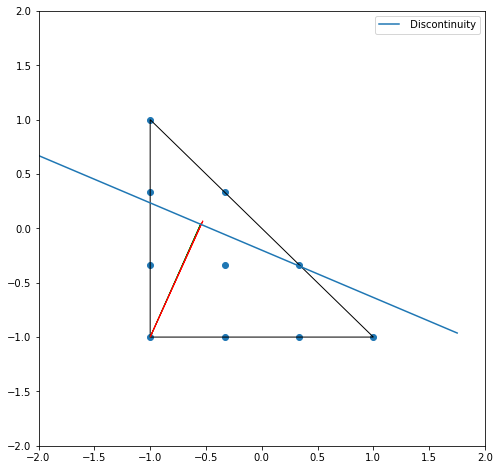

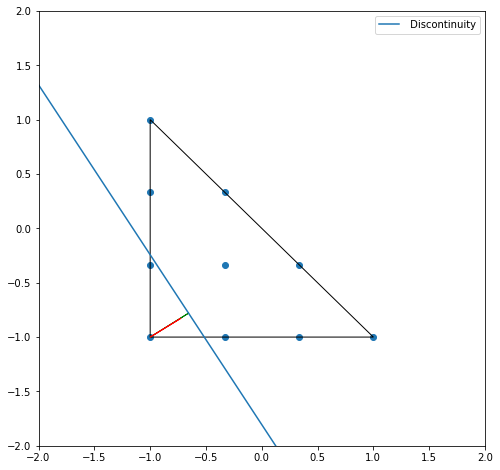

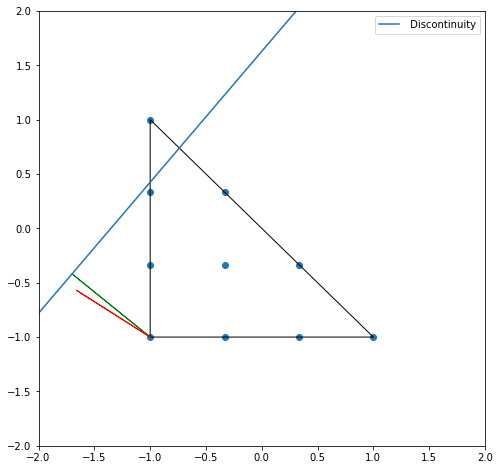

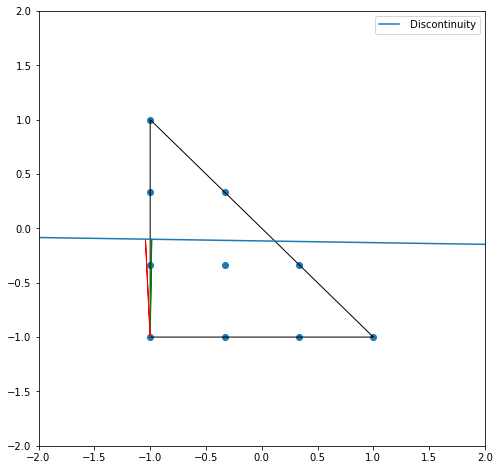

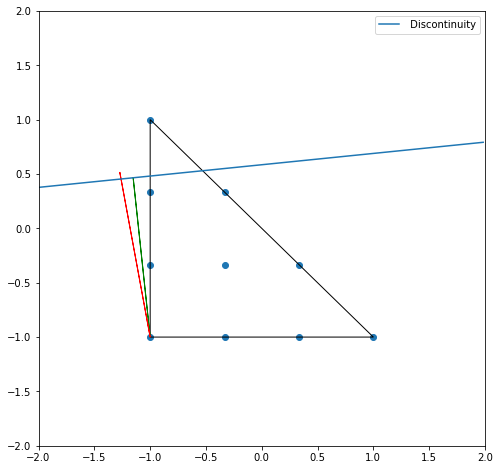

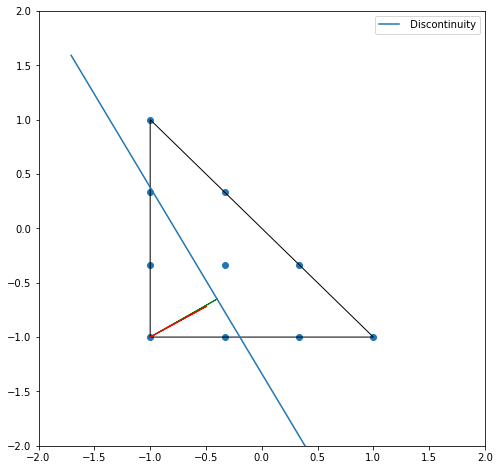

In [12]:
for i in range(10):
    visualisation_plot_3( [i] , true_angle , point_inter , model_1 , X_test , Y_test ,permuted_indice_test)

In [3]:
from keras import layers

In [4]:
from keras.utils.vis_utils import plot_model
import keras.backend as kb

In [110]:
def custum_loss(y_actual,y_pred):
    
    check = kb.sign(np.pi/2-y_pred)*np.pi
    val_1 = kb.square(y_actual-y_pred)
    val_2 = kb.square(y_actual-(y_pred+check))
    #val_3 = kb.square(y_actual-(y_pred-np.pi))
    #tmp = kb.minimum(val_3,val_2)
    tot = kb.minimum(val_1,val_2)
    return kb.mean(tot)


In [111]:
Dense_input = keras.Input(shape= (40,) , name = "FC_layers")
x = layers.Dense(40 , activation = 'sigmoid')(Dense_input)
x = layers.Dense(40 , activation = 'sigmoid')(x)
output_FC = layers.Dense(40 , activation = 'sigmoid')(x)

Dense_angle = layers.Dense(1,name='Angle_prediction')(output_FC)
Dense_ortho = layers.Dense(2 , name = 'Orthogonal_vector_pred')(output_FC)

model = keras.Model(
    inputs=[Dense_input],
    outputs=[Dense_angle, Dense_ortho],
)

model.compile(
    optimizer='adam',
    loss=[
        custum_loss,
        'mean_squared_error',
       
    ],
    loss_weights=[0.5, 0.5],
)



In [112]:
# Definition of the path of the data
data_path = 'C:\\Users\\pierr\\Desktop\\Projet de semestre I\\data\\task_2\\train_set\\discontinuity_0_1\\mesh_B\\data_set_p_3_all.csv'
# load the data 
data = np.loadtxt(data_path, delimiter=',')
ind = data[:,0]
point_inter = data[:,1:3]
data_nn = data[:,3:-1]
true_angle = data[:,-1]
print(data.shape)
print(data_nn.shape)
print(point_inter.shape)
print(true_angle.shape)

(11639, 46)
(11639, 42)
(11639, 2)
(11639,)


In [113]:
num_observation = np.shape(data)[0]
size_train = int(num_observation*0.8)
random_permuted_indices = np.random.permutation(num_observation)
data_shuffle = data[random_permuted_indices]
indice_neg = np.where(data_shuffle[:,-1]<0)[0]
data_shuffle[indice_neg,-1] += np.pi

X_train = data_shuffle[:size_train , 3:-3]
X_test = data_shuffle[size_train: , 3:-3]
Y_angle_train = data_shuffle[:size_train, -1]
Y_angle_test = data_shuffle[size_train:, -1]
Y_ortho_train = data_shuffle[:size_train , -3:-1]
Y_ortho_test = data_shuffle[size_train: , -3:-1]


In [114]:
model.fit(
    [X_train],
    [Y_angle_train , Y_ortho_train],
    epochs=1000,
    batch_size=1000,
)

Epoch 1/1000
9311/9311 [==============================] - 0s 14us/step - loss: 0.5961 - Angle_prediction_loss: 0.7948 - Orthogonal_vector_pred_loss: 0.3837
Epoch 2/1000
9311/9311 [==============================] - 0s 2us/step - loss: 0.4655 - Angle_prediction_loss: 0.6136 - Orthogonal_vector_pred_loss: 0.3145
Epoch 3/1000
9311/9311 [==============================] - 0s 2us/step - loss: 0.4509 - Angle_prediction_loss: 0.5905 - Orthogonal_vector_pred_loss: 0.3145
Epoch 4/1000
9311/9311 [==============================] - 0s 2us/step - loss: 0.4523 - Angle_prediction_loss: 0.5923 - Orthogonal_vector_pred_loss: 0.3116
Epoch 5/1000
9311/9311 [==============================] - 0s 2us/step - loss: 0.4475 - Angle_prediction_loss: 0.5850 - Orthogonal_vector_pred_loss: 0.3118
Epoch 6/1000
9311/9311 [==============================] - 0s 2us/step - loss: 0.4475 - Angle_prediction_loss: 0.5847 - Orthogonal_vector_pred_loss: 0.3113
Epoch 7/1000
9311/9311 [==============================] - 0s 2us/step

Epoch 104/1000
9311/9311 [==============================] - 0s 2us/step - loss: 0.0480 - Angle_prediction_loss: 0.0475 - Orthogonal_vector_pred_loss: 0.0477
Epoch 105/1000
9311/9311 [==============================] - 0s 2us/step - loss: 0.0476 - Angle_prediction_loss: 0.0479 - Orthogonal_vector_pred_loss: 0.0473
Epoch 106/1000
9311/9311 [==============================] - 0s 2us/step - loss: 0.0472 - Angle_prediction_loss: 0.0481 - Orthogonal_vector_pred_loss: 0.0473
Epoch 107/1000
9311/9311 [==============================] - 0s 2us/step - loss: 0.0467 - Angle_prediction_loss: 0.0460 - Orthogonal_vector_pred_loss: 0.0462
Epoch 108/1000
9311/9311 [==============================] - 0s 2us/step - loss: 0.0462 - Angle_prediction_loss: 0.0469 - Orthogonal_vector_pred_loss: 0.0464
Epoch 109/1000
9311/9311 [==============================] - 0s 2us/step - loss: 0.0459 - Angle_prediction_loss: 0.0460 - Orthogonal_vector_pred_loss: 0.0464
Epoch 110/1000
9311/9311 [==============================] 

9311/9311 [==============================] - 0s 2us/step - loss: 0.0210 - Angle_prediction_loss: 0.0235 - Orthogonal_vector_pred_loss: 0.0181
Epoch 207/1000
9311/9311 [==============================] - 0s 2us/step - loss: 0.0209 - Angle_prediction_loss: 0.0236 - Orthogonal_vector_pred_loss: 0.0179
Epoch 208/1000
9311/9311 [==============================] - 0s 2us/step - loss: 0.0208 - Angle_prediction_loss: 0.0239 - Orthogonal_vector_pred_loss: 0.0180
Epoch 209/1000
9311/9311 [==============================] - ETA: 0s - loss: 0.0194 - Angle_prediction_loss: 0.0212 - Orthogonal_vector_pred_loss: 0.017 - 0s 2us/step - loss: 0.0208 - Angle_prediction_loss: 0.0237 - Orthogonal_vector_pred_loss: 0.0179
Epoch 210/1000
9311/9311 [==============================] - 0s 2us/step - loss: 0.0206 - Angle_prediction_loss: 0.0227 - Orthogonal_vector_pred_loss: 0.0180
Epoch 211/1000
9311/9311 [==============================] - 0s 2us/step - loss: 0.0205 - Angle_prediction_loss: 0.0233 - Orthogonal_vect

9311/9311 [==============================] - 0s 2us/step - loss: 0.0163 - Angle_prediction_loss: 0.0188 - Orthogonal_vector_pred_loss: 0.0139
Epoch 306/1000
9311/9311 [==============================] - 0s 2us/step - loss: 0.0162 - Angle_prediction_loss: 0.0183 - Orthogonal_vector_pred_loss: 0.0138
Epoch 307/1000
9311/9311 [==============================] - 0s 2us/step - loss: 0.0164 - Angle_prediction_loss: 0.0186 - Orthogonal_vector_pred_loss: 0.0138
Epoch 308/1000
9311/9311 [==============================] - 0s 2us/step - loss: 0.0161 - Angle_prediction_loss: 0.0187 - Orthogonal_vector_pred_loss: 0.0136
Epoch 309/1000
9311/9311 [==============================] - 0s 2us/step - loss: 0.0161 - Angle_prediction_loss: 0.0182 - Orthogonal_vector_pred_loss: 0.0137
Epoch 310/1000
9311/9311 [==============================] - 0s 2us/step - loss: 0.0161 - Angle_prediction_loss: 0.0185 - Orthogonal_vector_pred_loss: 0.0140
Epoch 311/1000
9311/9311 [==============================] - 0s 2us/step -

9311/9311 [==============================] - 0s 2us/step - loss: 0.0147 - Angle_prediction_loss: 0.0173 - Orthogonal_vector_pred_loss: 0.0124
Epoch 405/1000
9311/9311 [==============================] - 0s 2us/step - loss: 0.0145 - Angle_prediction_loss: 0.0174 - Orthogonal_vector_pred_loss: 0.0123
Epoch 406/1000
9311/9311 [==============================] - 0s 2us/step - loss: 0.0142 - Angle_prediction_loss: 0.0163 - Orthogonal_vector_pred_loss: 0.0121
Epoch 407/1000
9311/9311 [==============================] - 0s 2us/step - loss: 0.0142 - Angle_prediction_loss: 0.0164 - Orthogonal_vector_pred_loss: 0.0123
Epoch 408/1000
9311/9311 [==============================] - 0s 2us/step - loss: 0.0142 - Angle_prediction_loss: 0.0160 - Orthogonal_vector_pred_loss: 0.0124
Epoch 409/1000
9311/9311 [==============================] - 0s 2us/step - loss: 0.0143 - Angle_prediction_loss: 0.0158 - Orthogonal_vector_pred_loss: 0.0122
Epoch 410/1000
9311/9311 [==============================] - 0s 2us/step -

9311/9311 [==============================] - 0s 2us/step - loss: 0.0130 - Angle_prediction_loss: 0.0146 - Orthogonal_vector_pred_loss: 0.0115
Epoch 502/1000
9311/9311 [==============================] - 0s 2us/step - loss: 0.0129 - Angle_prediction_loss: 0.0152 - Orthogonal_vector_pred_loss: 0.0113
Epoch 503/1000
9311/9311 [==============================] - 0s 2us/step - loss: 0.0131 - Angle_prediction_loss: 0.0147 - Orthogonal_vector_pred_loss: 0.0116
Epoch 504/1000
9311/9311 [==============================] - 0s 2us/step - loss: 0.0130 - Angle_prediction_loss: 0.0143 - Orthogonal_vector_pred_loss: 0.0115
Epoch 505/1000
9311/9311 [==============================] - 0s 2us/step - loss: 0.0130 - Angle_prediction_loss: 0.0148 - Orthogonal_vector_pred_loss: 0.0115
Epoch 506/1000
9311/9311 [==============================] - 0s 2us/step - loss: 0.0130 - Angle_prediction_loss: 0.0146 - Orthogonal_vector_pred_loss: 0.0113
Epoch 507/1000
9311/9311 [==============================] - 0s 2us/step -

9311/9311 [==============================] - 0s 2us/step - loss: 0.0121 - Angle_prediction_loss: 0.0133 - Orthogonal_vector_pred_loss: 0.0110
Epoch 602/1000
9311/9311 [==============================] - 0s 2us/step - loss: 0.0123 - Angle_prediction_loss: 0.0136 - Orthogonal_vector_pred_loss: 0.0108
Epoch 603/1000
9311/9311 [==============================] - 0s 2us/step - loss: 0.0122 - Angle_prediction_loss: 0.0132 - Orthogonal_vector_pred_loss: 0.0109
Epoch 604/1000
9311/9311 [==============================] - 0s 2us/step - loss: 0.0123 - Angle_prediction_loss: 0.0135 - Orthogonal_vector_pred_loss: 0.0111
Epoch 605/1000
9311/9311 [==============================] - 0s 2us/step - loss: 0.0121 - Angle_prediction_loss: 0.0132 - Orthogonal_vector_pred_loss: 0.0110
Epoch 606/1000
9311/9311 [==============================] - 0s 2us/step - loss: 0.0121 - Angle_prediction_loss: 0.0133 - Orthogonal_vector_pred_loss: 0.0109
Epoch 607/1000
9311/9311 [==============================] - 0s 2us/step -

9311/9311 [==============================] - 0s 2us/step - loss: 0.0114 - Angle_prediction_loss: 0.0119 - Orthogonal_vector_pred_loss: 0.0104
Epoch 703/1000
9311/9311 [==============================] - 0s 2us/step - loss: 0.0113 - Angle_prediction_loss: 0.0121 - Orthogonal_vector_pred_loss: 0.0104
Epoch 704/1000
9311/9311 [==============================] - 0s 2us/step - loss: 0.0114 - Angle_prediction_loss: 0.0124 - Orthogonal_vector_pred_loss: 0.0105
Epoch 705/1000
9311/9311 [==============================] - 0s 2us/step - loss: 0.0113 - Angle_prediction_loss: 0.0122 - Orthogonal_vector_pred_loss: 0.0105
Epoch 706/1000
9311/9311 [==============================] - 0s 2us/step - loss: 0.0113 - Angle_prediction_loss: 0.0120 - Orthogonal_vector_pred_loss: 0.0105
Epoch 707/1000
9311/9311 [==============================] - 0s 2us/step - loss: 0.0114 - Angle_prediction_loss: 0.0124 - Orthogonal_vector_pred_loss: 0.0105
Epoch 708/1000
9311/9311 [==============================] - 0s 2us/step -

9311/9311 [==============================] - 0s 2us/step - loss: 0.0108 - Angle_prediction_loss: 0.0112 - Orthogonal_vector_pred_loss: 0.0102
Epoch 803/1000
9311/9311 [==============================] - 0s 2us/step - loss: 0.0108 - Angle_prediction_loss: 0.0112 - Orthogonal_vector_pred_loss: 0.0103
Epoch 804/1000
9311/9311 [==============================] - 0s 2us/step - loss: 0.0108 - Angle_prediction_loss: 0.0113 - Orthogonal_vector_pred_loss: 0.0103
Epoch 805/1000
9311/9311 [==============================] - 0s 2us/step - loss: 0.0107 - Angle_prediction_loss: 0.0112 - Orthogonal_vector_pred_loss: 0.0102
Epoch 806/1000
9311/9311 [==============================] - 0s 2us/step - loss: 0.0108 - Angle_prediction_loss: 0.0114 - Orthogonal_vector_pred_loss: 0.0102
Epoch 807/1000
9311/9311 [==============================] - 0s 2us/step - loss: 0.0106 - Angle_prediction_loss: 0.0112 - Orthogonal_vector_pred_loss: 0.0103
Epoch 808/1000
9311/9311 [==============================] - 0s 2us/step -

9311/9311 [==============================] - 0s 2us/step - loss: 0.0103 - Angle_prediction_loss: 0.0105 - Orthogonal_vector_pred_loss: 0.0100
Epoch 902/1000
9311/9311 [==============================] - 0s 2us/step - loss: 0.0103 - Angle_prediction_loss: 0.0103 - Orthogonal_vector_pred_loss: 0.0100
Epoch 903/1000
9311/9311 [==============================] - 0s 2us/step - loss: 0.0102 - Angle_prediction_loss: 0.0102 - Orthogonal_vector_pred_loss: 0.0100
Epoch 904/1000
9311/9311 [==============================] - 0s 2us/step - loss: 0.0102 - Angle_prediction_loss: 0.0106 - Orthogonal_vector_pred_loss: 0.0100
Epoch 905/1000
9311/9311 [==============================] - 0s 2us/step - loss: 0.0102 - Angle_prediction_loss: 0.0106 - Orthogonal_vector_pred_loss: 0.0100
Epoch 906/1000
9311/9311 [==============================] - 0s 2us/step - loss: 0.0103 - Angle_prediction_loss: 0.0108 - Orthogonal_vector_pred_loss: 0.0100
Epoch 907/1000
9311/9311 [==============================] - 0s 2us/step -

In [11]:
Y = model.predict([X_test])

In [18]:
print(Y[1])

[[ 0.5114158   0.85953647]
 [-0.47459617  1.6289308 ]
 [ 0.59486616  0.6853935 ]
 ...
 [ 0.11397675  0.01217678]
 [ 0.37579185  1.7568052 ]
 [-0.00607135  0.95167726]]


In [19]:
test_mse = model.evaluate( [X_test] , [Y_angle_test , Y_ortho_test ], verbose=0)

In [20]:
print(test_mse)

[0.00914865206363787, 0.007947644218802452, 0.010357938706874847]


In [91]:
def visualisation_plot_2(indice ,point_inter, model , X_test , Y_angle_test ,Y_ortho_test ):
    
    x = X_test[indice]
    y_angle = Y_angle_test[indice]
    y_ortho = Y_ortho_test[indice]
    point = point_inter[indice]
    
    direction = np.array([ np.cos(y_angle) ,np.sin(y_angle) ])
    y_pred = model.predict([x] , verbose = 0)
    y_angle_pred = y_pred[0]
    y_ortho_pred = y_pred[1]
    direction_pred = np.array([ np.cos(y_angle_pred) ,np.sin(y_angle_pred) ])
    
    VA = -np.ones((2))
    pts = np.array([[-1,-1],[-1,1],[1,-1]])
    lam = np.linspace(3,-3,1000)
    interpolate_space = np.linspace(-1,1,4)
    interpolate_space_flip = np.flip(interpolate_space)
    interpolate_point = np.ones((2,10))
    p=0
    for i in range(4):
        for j in range(i+1):
            interpolate_point[0,p]=interpolate_space_flip[i]
            interpolate_point[1,p]=interpolate_space[j]
            p +=1 
    
    plt.figure(figsize=(8,8))
    # plot the triangle in the reference space
    triangle = plt.Polygon(pts,fill=False)
    plt.gca().add_patch(triangle)
    # plot the interpolate point
    plt.scatter(interpolate_point[0,:],interpolate_point[1,:])
    # plot the prediction 
    plt.plot(point[0,0] + lam*direction[0,0] ,point[0,1] + lam*direction[1,0] , label=' Discontinuity' )
    plt.arrow(-1,-1,y_ortho[0,0],y_ortho[0,1],color='g' ,label = ' true orthogonal vector')
    plt.arrow(-1 ,-1 , y_ortho_pred[0,0] , y_ortho_pred[0,1],color='r'  , label = ' predict orthogonal vector ')
    plt.plot(y_ortho_pred[0,0]-1 + lam*direction_pred[0,0] ,y_ortho_pred[0,1]-1 + lam*direction_pred[1,0] , label=' Discontinuity prediction' )
    
    plt.xlim(-2,2)
    plt.ylim(-2,2)
    plt.legend()
    plt.show()
    

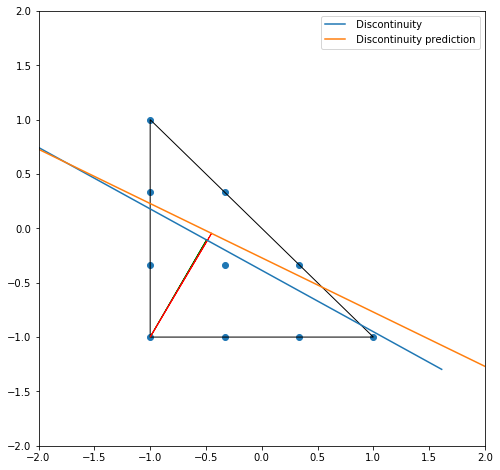

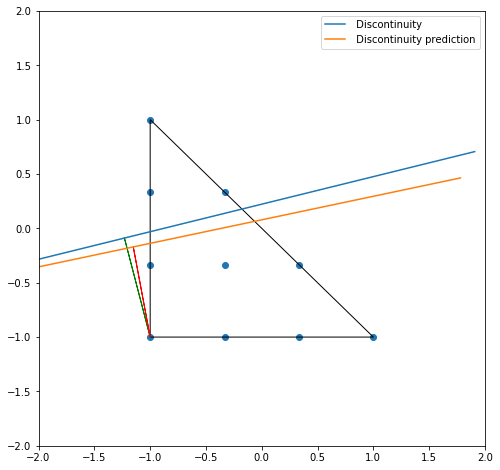

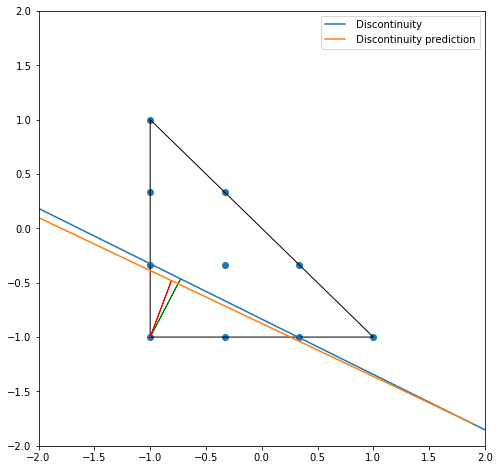

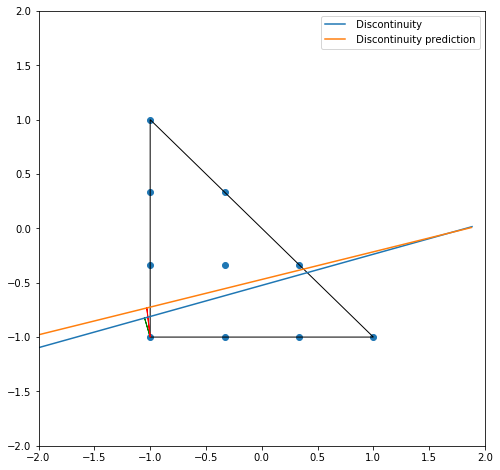

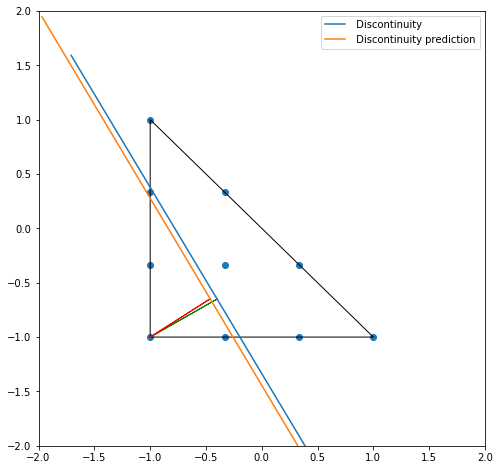

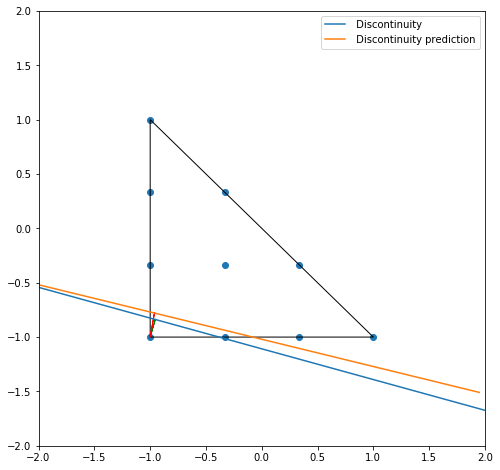

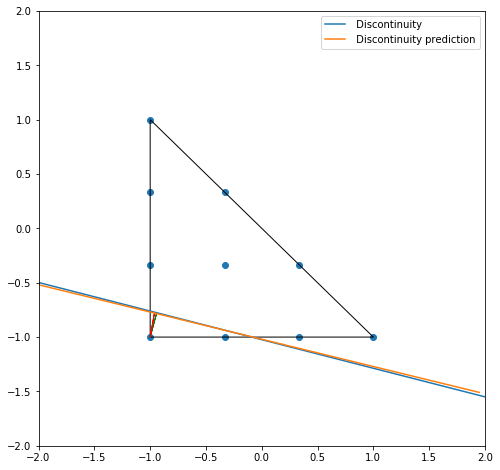

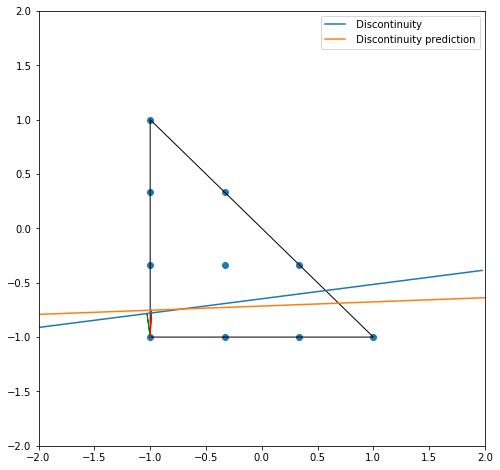

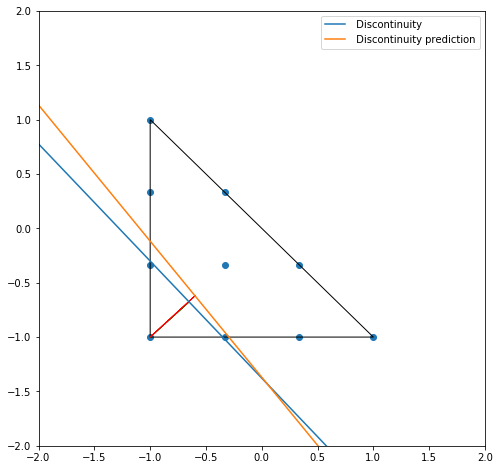

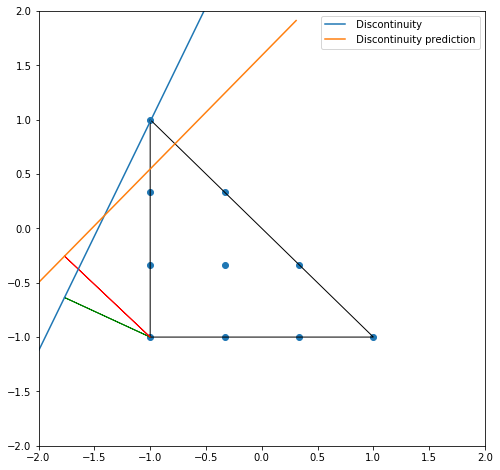

In [115]:
point = data_shuffle[size_train: , 1:3]
for i in range(10):
    visualisation_plot_2([i] ,point, model , X_test , Y_angle_test ,Y_ortho_test )

In [62]:
def compute_error(y_pred , y_true):
    check = np.sign( np.pi/2 - y_pred )*np.pi
    val1 = np.abs(y_pred-y_true)
    val2 = np.abs(y_true -(y_pred+check))
    return np.minimum(val1,val2)

In [68]:
Y = model.predict(X_test , verbose = 0 )

error = Y_angle_test - Y[0][:,0]
print((Y[0][:,0]).shape)
indice_error = np.where(error>1)[0]

error_2 = compute_error(Y[0][:,0] , Y_angle_test)
indice_error_2 = np.where(error_2>0.1)[0]
print(indice_error_2.shape)

(2328,)
(503,)


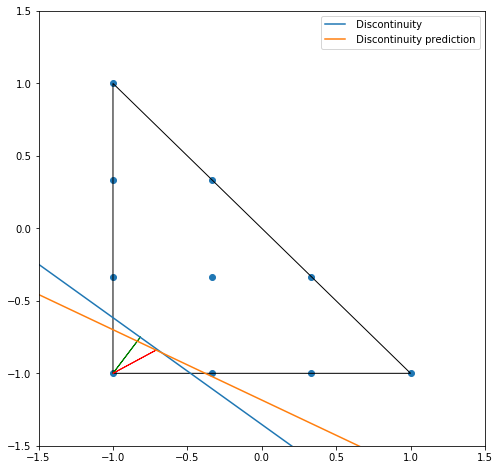

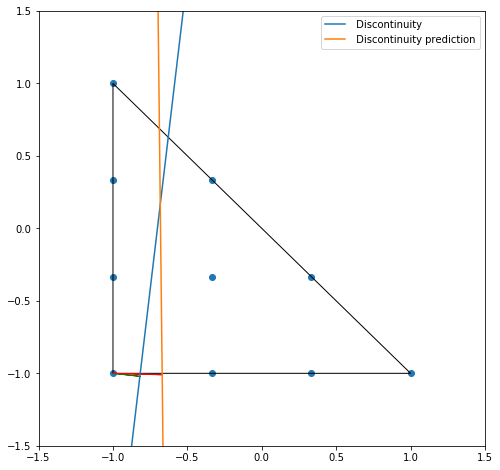

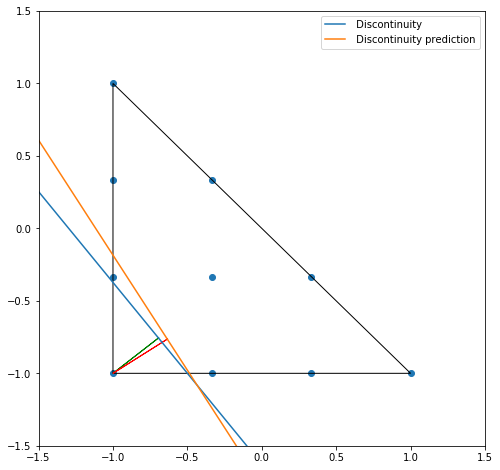

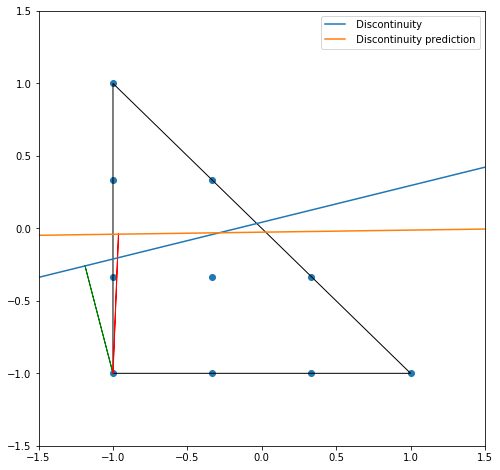

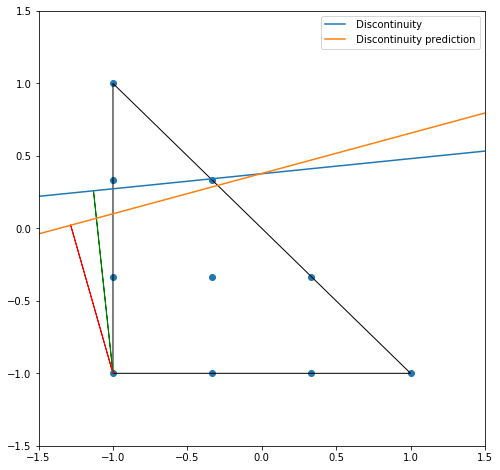

...

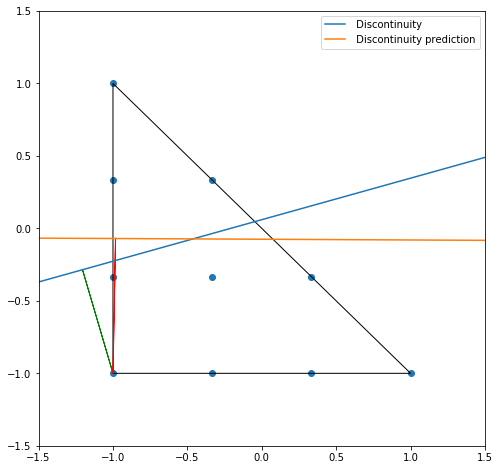

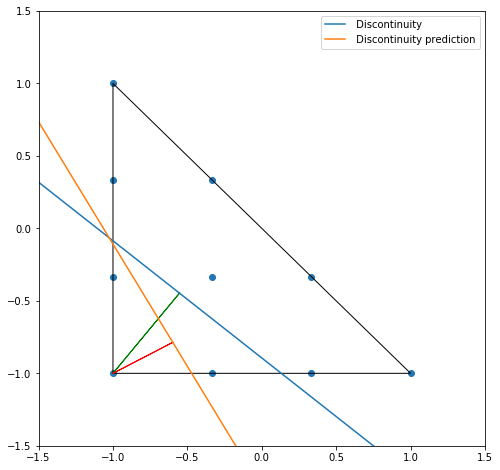

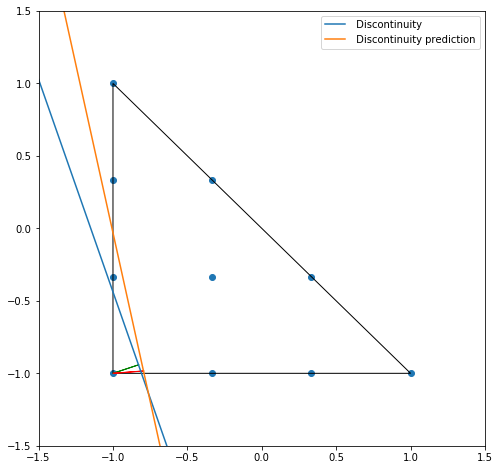

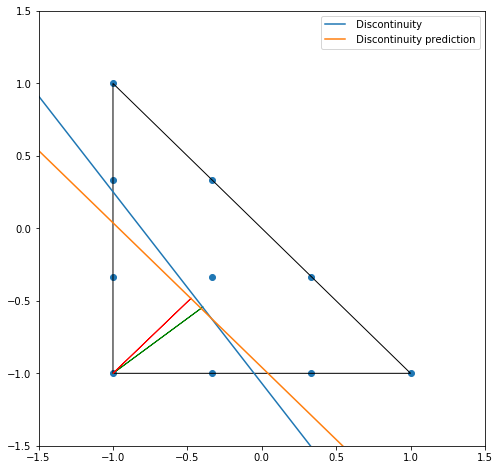

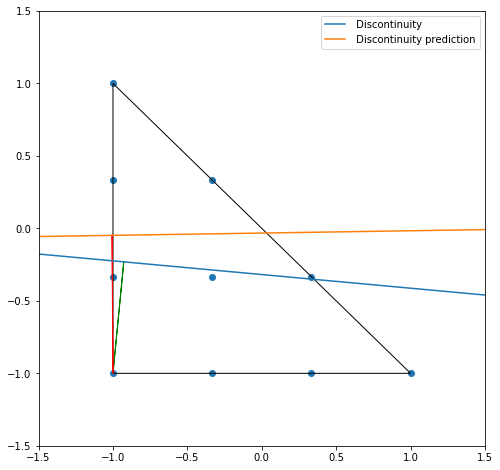

In [69]:
for ind in indice_error_2 :
    visualisation_plot_2( [ind] ,point, model , X_test , Y_angle_test ,Y_ortho_test)

## Model prediction combining two method

In [70]:
def get_model():
    Dense_input = keras.Input(shape= (40,) , name = "FC_layers")
    x = layers.Dense(40 , activation = 'sigmoid')(Dense_input)
    x = layers.Dense(40 , activation = 'sigmoid')(x)
    output_FC = layers.Dense(40 , activation = 'sigmoid')(x)

    Dense_angle = layers.Dense(1,name='Angle_prediction')(output_FC)
    Dense_ortho = layers.Dense(2 , name = 'Orthogonal_vector_pred')(output_FC)

    model = keras.Model(
        inputs=[Dense_input],
        outputs=[Dense_angle, Dense_ortho],
    )

    model.compile(
        optimizer='adam',
        loss=[
            custum_loss,
            'mean_squared_error',

        ],
        loss_weights=[0.5, 0.5],
    )
    return model 

#### Average model predictions 

In [78]:
model1 = get_model()
model2 = get_model()
model3 = get_model()
model4 = get_model()
model5 = get_model()

inputs = keras.Input(shape=(40,))
y1 = model1(inputs)
y2 = model2(inputs)
y3 = model3(inputs)
y4 = model4(inputs)
y5 = model5(inputs)

outputs_1 = layers.Average()([y1[0] ,y2[0] , y3[0],y4[0] , y5[0] ])
outputs_2 = layers.Average()([y1[1] ,y2[1] , y3[1],y4[1] , y5[1] ])

ensemble_model = keras.Model(inputs=inputs, outputs= [outputs_1 ,outputs_2 ])

In [79]:
ensemble_model.compile(
        optimizer='adam',
        loss=[
            custum_loss,
            'mean_squared_error',

        ],
        loss_weights=[0.5, 0.5],
    )

In [80]:
ensemble_model.fit(
    [X_train],
    [Y_angle_train , Y_ortho_train],
    epochs=2000,
    batch_size=100,
)

Epoch 1/2000
9311/9311 [==============================] - 1s 67us/step - loss: 0.4719 - average_6_loss: 0.6291 - average_7_loss: 0.3151
Epoch 2/2000
9311/9311 [==============================] - 0s 18us/step - loss: 0.4478 - average_6_loss: 0.5856 - average_7_loss: 0.3096
Epoch 3/2000
9311/9311 [==============================] - 0s 18us/step - loss: 0.4375 - average_6_loss: 0.5687 - average_7_loss: 0.3038
Epoch 4/2000
9311/9311 [==============================] - 0s 18us/step - loss: 0.3945 - average_6_loss: 0.5122 - average_7_loss: 0.2799
Epoch 5/2000
9311/9311 [==============================] - 0s 18us/step - loss: 0.3046 - average_6_loss: 0.3810 - average_7_loss: 0.2280
Epoch 6/2000
9311/9311 [==============================] - 0s 17us/step - loss: 0.2070 - average_6_loss: 0.2522 - average_7_loss: 0.1603
Epoch 7/2000
9311/9311 [==============================] - 0s 18us/step - loss: 0.1539 - average_6_loss: 0.1863 - average_7_loss: 0.1204
Epoch 8/2000
9311/9311 [========================

9311/9311 [==============================] - 0s 17us/step - loss: 0.0082 - average_6_loss: 0.0073 - average_7_loss: 0.0092
Epoch 120/2000
9311/9311 [==============================] - 0s 18us/step - loss: 0.0081 - average_6_loss: 0.0071 - average_7_loss: 0.0091
Epoch 121/2000
9311/9311 [==============================] - 0s 18us/step - loss: 0.0083 - average_6_loss: 0.0074 - average_7_loss: 0.0091
Epoch 122/2000
9311/9311 [==============================] - 0s 18us/step - loss: 0.0083 - average_6_loss: 0.0073 - average_7_loss: 0.0092
Epoch 123/2000
9311/9311 [==============================] - 0s 17us/step - loss: 0.0082 - average_6_loss: 0.0072 - average_7_loss: 0.0093
Epoch 124/2000
9311/9311 [==============================] - 0s 17us/step - loss: 0.0083 - average_6_loss: 0.0073 - average_7_loss: 0.0093
Epoch 125/2000
9311/9311 [==============================] - 0s 18us/step - loss: 0.0082 - average_6_loss: 0.0072 - average_7_loss: 0.0092
Epoch 126/2000
9311/9311 [=======================

9311/9311 [==============================] - 0s 18us/step - loss: 0.0078 - average_6_loss: 0.0070 - average_7_loss: 0.0087
Epoch 237/2000
9311/9311 [==============================] - 0s 18us/step - loss: 0.0080 - average_6_loss: 0.0072 - average_7_loss: 0.0088
Epoch 238/2000
9311/9311 [==============================] - 0s 18us/step - loss: 0.0078 - average_6_loss: 0.0071 - average_7_loss: 0.0087
Epoch 239/2000
9311/9311 [==============================] - 0s 18us/step - loss: 0.0078 - average_6_loss: 0.0070 - average_7_loss: 0.0087
Epoch 240/2000
9311/9311 [==============================] - 0s 18us/step - loss: 0.0078 - average_6_loss: 0.0069 - average_7_loss: 0.0086
Epoch 241/2000
9311/9311 [==============================] - 0s 18us/step - loss: 0.0077 - average_6_loss: 0.0068 - average_7_loss: 0.0085
Epoch 242/2000
9311/9311 [==============================] - 0s 18us/step - loss: 0.0078 - average_6_loss: 0.0069 - average_7_loss: 0.0087
Epoch 243/2000
9311/9311 [=======================

9311/9311 [==============================] - 0s 18us/step - loss: 0.0075 - average_6_loss: 0.0067 - average_7_loss: 0.0084
Epoch 353/2000
9311/9311 [==============================] - 0s 18us/step - loss: 0.0075 - average_6_loss: 0.0067 - average_7_loss: 0.0083
Epoch 354/2000
9311/9311 [==============================] - 0s 18us/step - loss: 0.0075 - average_6_loss: 0.0068 - average_7_loss: 0.0083
Epoch 355/2000
9311/9311 [==============================] - 0s 18us/step - loss: 0.0075 - average_6_loss: 0.0067 - average_7_loss: 0.0083
Epoch 356/2000
9311/9311 [==============================] - 0s 18us/step - loss: 0.0075 - average_6_loss: 0.0066 - average_7_loss: 0.0083
Epoch 357/2000
9311/9311 [==============================] - 0s 18us/step - loss: 0.0075 - average_6_loss: 0.0068 - average_7_loss: 0.0084
Epoch 358/2000
9311/9311 [==============================] - 0s 18us/step - loss: 0.0075 - average_6_loss: 0.0067 - average_7_loss: 0.0082
Epoch 359/2000
9311/9311 [=======================

9311/9311 [==============================] - 0s 18us/step - loss: 0.0074 - average_6_loss: 0.0065 - average_7_loss: 0.0081
Epoch 468/2000
9311/9311 [==============================] - 0s 18us/step - loss: 0.0074 - average_6_loss: 0.0065 - average_7_loss: 0.0081
Epoch 469/2000
9311/9311 [==============================] - 0s 19us/step - loss: 0.0074 - average_6_loss: 0.0066 - average_7_loss: 0.0082
Epoch 470/2000
9311/9311 [==============================] - 0s 18us/step - loss: 0.0075 - average_6_loss: 0.0067 - average_7_loss: 0.0082
Epoch 471/2000
9311/9311 [==============================] - 0s 18us/step - loss: 0.0074 - average_6_loss: 0.0066 - average_7_loss: 0.0082
Epoch 472/2000
9311/9311 [==============================] - 0s 18us/step - loss: 0.0073 - average_6_loss: 0.0065 - average_7_loss: 0.0081
Epoch 473/2000
9311/9311 [==============================] - ETA: 0s - loss: 0.0073 - average_6_loss: 0.0065 - average_7_loss: 0.008 - 0s 18us/step - loss: 0.0073 - average_6_loss: 0.0065 

9311/9311 [==============================] - ETA: 0s - loss: 0.0072 - average_6_loss: 0.0063 - average_7_loss: 0.008 - 0s 19us/step - loss: 0.0072 - average_6_loss: 0.0064 - average_7_loss: 0.0080
Epoch 582/2000
9311/9311 [==============================] - 0s 18us/step - loss: 0.0072 - average_6_loss: 0.0065 - average_7_loss: 0.0080
Epoch 583/2000
9311/9311 [==============================] - 0s 18us/step - loss: 0.0073 - average_6_loss: 0.0065 - average_7_loss: 0.0080
Epoch 584/2000
9311/9311 [==============================] - 0s 18us/step - loss: 0.0072 - average_6_loss: 0.0064 - average_7_loss: 0.0079
Epoch 585/2000
9311/9311 [==============================] - 0s 18us/step - loss: 0.0073 - average_6_loss: 0.0065 - average_7_loss: 0.0080
Epoch 586/2000
9311/9311 [==============================] - 0s 18us/step - loss: 0.0072 - average_6_loss: 0.0064 - average_7_loss: 0.0079
Epoch 587/2000
9311/9311 [==============================] - 0s 17us/step - loss: 0.0072 - average_6_loss: 0.0065 

9311/9311 [==============================] - 0s 18us/step - loss: 0.0071 - average_6_loss: 0.0065 - average_7_loss: 0.0080
Epoch 695/2000
9311/9311 [==============================] - 0s 18us/step - loss: 0.0071 - average_6_loss: 0.0064 - average_7_loss: 0.0079
Epoch 696/2000
9311/9311 [==============================] - 0s 18us/step - loss: 0.0071 - average_6_loss: 0.0064 - average_7_loss: 0.0078
Epoch 697/2000
9311/9311 [==============================] - 0s 18us/step - loss: 0.0072 - average_6_loss: 0.0065 - average_7_loss: 0.0079
Epoch 698/2000
9311/9311 [==============================] - 0s 18us/step - loss: 0.0071 - average_6_loss: 0.0063 - average_7_loss: 0.0079
Epoch 699/2000
9311/9311 [==============================] - 0s 19us/step - loss: 0.0071 - average_6_loss: 0.0064 - average_7_loss: 0.0078
Epoch 700/2000
9311/9311 [==============================] - 0s 18us/step - loss: 0.0071 - average_6_loss: 0.0064 - average_7_loss: 0.0079
Epoch 701/2000
9311/9311 [=======================

9311/9311 [==============================] - 0s 18us/step - loss: 0.0071 - average_6_loss: 0.0065 - average_7_loss: 0.0079
Epoch 812/2000
9311/9311 [==============================] - 0s 18us/step - loss: 0.0070 - average_6_loss: 0.0063 - average_7_loss: 0.0078
Epoch 813/2000
9311/9311 [==============================] - 0s 18us/step - loss: 0.0070 - average_6_loss: 0.0062 - average_7_loss: 0.0077
Epoch 814/2000
9311/9311 [==============================] - 0s 18us/step - loss: 0.0070 - average_6_loss: 0.0063 - average_7_loss: 0.0077
Epoch 815/2000
9311/9311 [==============================] - 0s 18us/step - loss: 0.0070 - average_6_loss: 0.0063 - average_7_loss: 0.0078
Epoch 816/2000
9311/9311 [==============================] - 0s 18us/step - loss: 0.0070 - average_6_loss: 0.0063 - average_7_loss: 0.0078
Epoch 817/2000
9311/9311 [==============================] - 0s 18us/step - loss: 0.0070 - average_6_loss: 0.0063 - average_7_loss: 0.0077
Epoch 818/2000
9311/9311 [=======================

9311/9311 [==============================] - 0s 18us/step - loss: 0.0069 - average_6_loss: 0.0062 - average_7_loss: 0.0077
Epoch 926/2000
9311/9311 [==============================] - 0s 18us/step - loss: 0.0070 - average_6_loss: 0.0062 - average_7_loss: 0.0077
Epoch 927/2000
9311/9311 [==============================] - 0s 18us/step - loss: 0.0070 - average_6_loss: 0.0063 - average_7_loss: 0.0077
Epoch 928/2000
9311/9311 [==============================] - 0s 18us/step - loss: 0.0069 - average_6_loss: 0.0062 - average_7_loss: 0.0077
Epoch 929/2000
9311/9311 [==============================] - 0s 18us/step - loss: 0.0069 - average_6_loss: 0.0062 - average_7_loss: 0.0076
Epoch 930/2000
9311/9311 [==============================] - 0s 18us/step - loss: 0.0069 - average_6_loss: 0.0061 - average_7_loss: 0.0076
Epoch 931/2000
9311/9311 [==============================] - 0s 18us/step - loss: 0.0070 - average_6_loss: 0.0063 - average_7_loss: 0.0078
Epoch 932/2000
9311/9311 [=======================

9311/9311 [==============================] - 0s 18us/step - loss: 0.0069 - average_6_loss: 0.0062 - average_7_loss: 0.0076
Epoch 1042/2000
9311/9311 [==============================] - 0s 18us/step - loss: 0.0069 - average_6_loss: 0.0062 - average_7_loss: 0.0076
Epoch 1043/2000
9311/9311 [==============================] - 0s 19us/step - loss: 0.0068 - average_6_loss: 0.0061 - average_7_loss: 0.0075
Epoch 1044/2000
9311/9311 [==============================] - 0s 18us/step - loss: 0.0070 - average_6_loss: 0.0062 - average_7_loss: 0.0077
Epoch 1045/2000
9311/9311 [==============================] - 0s 19us/step - loss: 0.0069 - average_6_loss: 0.0061 - average_7_loss: 0.0077
Epoch 1046/2000
9311/9311 [==============================] - 0s 18us/step - loss: 0.0068 - average_6_loss: 0.0062 - average_7_loss: 0.0076
Epoch 1047/2000
9311/9311 [==============================] - 0s 19us/step - loss: 0.0069 - average_6_loss: 0.0061 - average_7_loss: 0.0076
Epoch 1048/2000
9311/9311 [================

9311/9311 [==============================] - 0s 19us/step - loss: 0.0069 - average_6_loss: 0.0062 - average_7_loss: 0.0077
Epoch 1100/2000
9311/9311 [==============================] - 0s 19us/step - loss: 0.0069 - average_6_loss: 0.0061 - average_7_loss: 0.0076
Epoch 1101/2000
9311/9311 [==============================] - 0s 18us/step - loss: 0.0068 - average_6_loss: 0.0061 - average_7_loss: 0.0075
Epoch 1102/2000
9311/9311 [==============================] - 0s 18us/step - loss: 0.0068 - average_6_loss: 0.0061 - average_7_loss: 0.0076
Epoch 1103/2000
9311/9311 [==============================] - 0s 19us/step - loss: 0.0069 - average_6_loss: 0.0061 - average_7_loss: 0.0077
Epoch 1104/2000
9311/9311 [==============================] - 0s 19us/step - loss: 0.0068 - average_6_loss: 0.0060 - average_7_loss: 0.0075
Epoch 1105/2000
9311/9311 [==============================] - 0s 19us/step - loss: 0.0069 - average_6_loss: 0.0061 - average_7_loss: 0.0076
Epoch 1106/2000
9311/9311 [================

9311/9311 [==============================] - 0s 18us/step - loss: 0.0068 - average_6_loss: 0.0060 - average_7_loss: 0.0075
Epoch 1215/2000
9311/9311 [==============================] - 0s 18us/step - loss: 0.0068 - average_6_loss: 0.0061 - average_7_loss: 0.0077
Epoch 1216/2000
9311/9311 [==============================] - 0s 18us/step - loss: 0.0068 - average_6_loss: 0.0061 - average_7_loss: 0.0076
Epoch 1217/2000
9311/9311 [==============================] - 0s 18us/step - loss: 0.0068 - average_6_loss: 0.0062 - average_7_loss: 0.0075
Epoch 1218/2000
9311/9311 [==============================] - 0s 18us/step - loss: 0.0068 - average_6_loss: 0.0061 - average_7_loss: 0.0075
Epoch 1219/2000
9311/9311 [==============================] - 0s 18us/step - loss: 0.0068 - average_6_loss: 0.0061 - average_7_loss: 0.0075
Epoch 1220/2000
9311/9311 [==============================] - 0s 18us/step - loss: 0.0068 - average_6_loss: 0.0061 - average_7_loss: 0.0075
Epoch 1221/2000
9311/9311 [================

Epoch 1330/2000
9311/9311 [==============================] - 0s 18us/step - loss: 0.0068 - average_6_loss: 0.0060 - average_7_loss: 0.0075
Epoch 1331/2000
9311/9311 [==============================] - 0s 18us/step - loss: 0.0067 - average_6_loss: 0.0061 - average_7_loss: 0.0075
Epoch 1332/2000
9311/9311 [==============================] - 0s 18us/step - loss: 0.0068 - average_6_loss: 0.0061 - average_7_loss: 0.0074
Epoch 1333/2000
9311/9311 [==============================] - 0s 18us/step - loss: 0.0068 - average_6_loss: 0.0060 - average_7_loss: 0.0075
Epoch 1334/2000
9311/9311 [==============================] - 0s 18us/step - loss: 0.0067 - average_6_loss: 0.0060 - average_7_loss: 0.0074
Epoch 1335/2000
9311/9311 [==============================] - 0s 18us/step - loss: 0.0069 - average_6_loss: 0.0061 - average_7_loss: 0.0076
Epoch 1336/2000
9311/9311 [==============================] - 0s 18us/step - loss: 0.0068 - average_6_loss: 0.0061 - average_7_loss: 0.0075
Epoch 1337/2000
9311/9311 [

9311/9311 [==============================] - 0s 19us/step - loss: 0.0067 - average_6_loss: 0.0060 - average_7_loss: 0.0074
Epoch 1441/2000
9311/9311 [==============================] - ETA: 0s - loss: 0.0067 - average_6_loss: 0.0059 - average_7_loss: 0.007 - 0s 18us/step - loss: 0.0067 - average_6_loss: 0.0060 - average_7_loss: 0.0074
Epoch 1442/2000
9311/9311 [==============================] - 0s 18us/step - loss: 0.0068 - average_6_loss: 0.0060 - average_7_loss: 0.0075
Epoch 1443/2000
9311/9311 [==============================] - ETA: 0s - loss: 0.0067 - average_6_loss: 0.0060 - average_7_loss: 0.007 - 0s 18us/step - loss: 0.0067 - average_6_loss: 0.0060 - average_7_loss: 0.0073
Epoch 1444/2000
9311/9311 [==============================] - 0s 18us/step - loss: 0.0067 - average_6_loss: 0.0060 - average_7_loss: 0.0073
Epoch 1445/2000
9311/9311 [==============================] - 0s 18us/step - loss: 0.0067 - average_6_loss: 0.0060 - average_7_loss: 0.0073
Epoch 1446/2000
9311/9311 [=======

Epoch 1498/2000
9311/9311 [==============================] - 0s 18us/step - loss: 0.0067 - average_6_loss: 0.0060 - average_7_loss: 0.0074
Epoch 1499/2000
9311/9311 [==============================] - 0s 18us/step - loss: 0.0068 - average_6_loss: 0.0060 - average_7_loss: 0.0074
Epoch 1500/2000
9311/9311 [==============================] - 0s 18us/step - loss: 0.0067 - average_6_loss: 0.0061 - average_7_loss: 0.0074
Epoch 1501/2000
9311/9311 [==============================] - 0s 18us/step - loss: 0.0067 - average_6_loss: 0.0060 - average_7_loss: 0.0073
Epoch 1502/2000
9311/9311 [==============================] - 0s 18us/step - loss: 0.0067 - average_6_loss: 0.0060 - average_7_loss: 0.0074
Epoch 1503/2000
9311/9311 [==============================] - 0s 18us/step - loss: 0.0067 - average_6_loss: 0.0060 - average_7_loss: 0.0074
Epoch 1504/2000
9311/9311 [==============================] - 0s 18us/step - loss: 0.0067 - average_6_loss: 0.0060 - average_7_loss: 0.0074
Epoch 1505/2000
9311/9311 [

9311/9311 [==============================] - 0s 18us/step - loss: 0.0066 - average_6_loss: 0.0060 - average_7_loss: 0.0073
Epoch 1614/2000
9311/9311 [==============================] - ETA: 0s - loss: 0.0066 - average_6_loss: 0.0059 - average_7_loss: 0.007 - 0s 18us/step - loss: 0.0066 - average_6_loss: 0.0059 - average_7_loss: 0.0074
Epoch 1615/2000
9311/9311 [==============================] - 0s 18us/step - loss: 0.0067 - average_6_loss: 0.0061 - average_7_loss: 0.0075
Epoch 1616/2000
9311/9311 [==============================] - 0s 18us/step - loss: 0.0067 - average_6_loss: 0.0060 - average_7_loss: 0.0073
Epoch 1617/2000
9311/9311 [==============================] - 0s 18us/step - loss: 0.0067 - average_6_loss: 0.0060 - average_7_loss: 0.0074
Epoch 1618/2000
9311/9311 [==============================] - 0s 18us/step - loss: 0.0066 - average_6_loss: 0.0059 - average_7_loss: 0.0073
Epoch 1619/2000
9311/9311 [==============================] - 0s 18us/step - loss: 0.0066 - average_6_loss: 0

Epoch 1670/2000
9311/9311 [==============================] - 0s 19us/step - loss: 0.0066 - average_6_loss: 0.0059 - average_7_loss: 0.0073
Epoch 1671/2000
9311/9311 [==============================] - 0s 18us/step - loss: 0.0066 - average_6_loss: 0.0059 - average_7_loss: 0.0073
Epoch 1672/2000
9311/9311 [==============================] - 0s 19us/step - loss: 0.0067 - average_6_loss: 0.0060 - average_7_loss: 0.0073
Epoch 1673/2000
9311/9311 [==============================] - 0s 19us/step - loss: 0.0066 - average_6_loss: 0.0060 - average_7_loss: 0.0074
Epoch 1674/2000
9311/9311 [==============================] - 0s 18us/step - loss: 0.0067 - average_6_loss: 0.0060 - average_7_loss: 0.0074
Epoch 1675/2000
9311/9311 [==============================] - 0s 18us/step - loss: 0.0066 - average_6_loss: 0.0059 - average_7_loss: 0.0073
Epoch 1676/2000
9311/9311 [==============================] - ETA: 0s - loss: 0.0066 - average_6_loss: 0.0059 - average_7_loss: 0.007 - 0s 18us/step - loss: 0.0066 - a

9311/9311 [==============================] - 0s 19us/step - loss: 0.0066 - average_6_loss: 0.0059 - average_7_loss: 0.0073
Epoch 1786/2000
9311/9311 [==============================] - 0s 19us/step - loss: 0.0066 - average_6_loss: 0.0059 - average_7_loss: 0.0073
Epoch 1787/2000
9311/9311 [==============================] - 0s 18us/step - loss: 0.0066 - average_6_loss: 0.0060 - average_7_loss: 0.0073
Epoch 1788/2000
9311/9311 [==============================] - 0s 19us/step - loss: 0.0066 - average_6_loss: 0.0059 - average_7_loss: 0.0073
Epoch 1789/2000
9311/9311 [==============================] - 0s 19us/step - loss: 0.0066 - average_6_loss: 0.0060 - average_7_loss: 0.0073
Epoch 1790/2000
9311/9311 [==============================] - 0s 18us/step - loss: 0.0066 - average_6_loss: 0.0059 - average_7_loss: 0.0073
Epoch 1791/2000
9311/9311 [==============================] - 0s 18us/step - loss: 0.0066 - average_6_loss: 0.0059 - average_7_loss: 0.0072
Epoch 1792/2000
9311/9311 [================

9311/9311 [==============================] - 0s 18us/step - loss: 0.0066 - average_6_loss: 0.0059 - average_7_loss: 0.0073
Epoch 1844/2000
9311/9311 [==============================] - 0s 18us/step - loss: 0.0066 - average_6_loss: 0.0059 - average_7_loss: 0.0072
Epoch 1845/2000
9311/9311 [==============================] - 0s 18us/step - loss: 0.0066 - average_6_loss: 0.0059 - average_7_loss: 0.0072
Epoch 1846/2000
9311/9311 [==============================] - 0s 18us/step - loss: 0.0066 - average_6_loss: 0.0059 - average_7_loss: 0.0072
Epoch 1847/2000
9311/9311 [==============================] - 0s 18us/step - loss: 0.0066 - average_6_loss: 0.0059 - average_7_loss: 0.0073
Epoch 1848/2000
9311/9311 [==============================] - ETA: 0s - loss: 0.0066 - average_6_loss: 0.0060 - average_7_loss: 0.007 - 0s 18us/step - loss: 0.0066 - average_6_loss: 0.0060 - average_7_loss: 0.0073
Epoch 1849/2000
9311/9311 [==============================] - 0s 18us/step - loss: 0.0066 - average_6_loss: 0

Epoch 1901/2000
9311/9311 [==============================] - 0s 18us/step - loss: 0.0066 - average_6_loss: 0.0059 - average_7_loss: 0.0072
Epoch 1902/2000
9311/9311 [==============================] - 0s 18us/step - loss: 0.0066 - average_6_loss: 0.0059 - average_7_loss: 0.0072
Epoch 1903/2000
9311/9311 [==============================] - 0s 19us/step - loss: 0.0066 - average_6_loss: 0.0060 - average_7_loss: 0.0074
Epoch 1904/2000
9311/9311 [==============================] - 0s 18us/step - loss: 0.0066 - average_6_loss: 0.0059 - average_7_loss: 0.0073
Epoch 1905/2000
9311/9311 [==============================] - 0s 18us/step - loss: 0.0066 - average_6_loss: 0.0059 - average_7_loss: 0.0074
Epoch 1906/2000
9311/9311 [==============================] - 0s 19us/step - loss: 0.0066 - average_6_loss: 0.0059 - average_7_loss: 0.0072
Epoch 1907/2000
9311/9311 [==============================] - 0s 18us/step - loss: 0.0066 - average_6_loss: 0.0060 - average_7_loss: 0.0075
Epoch 1908/2000
9311/9311 [

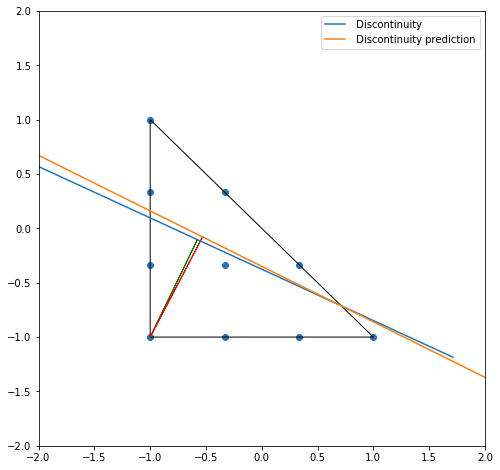

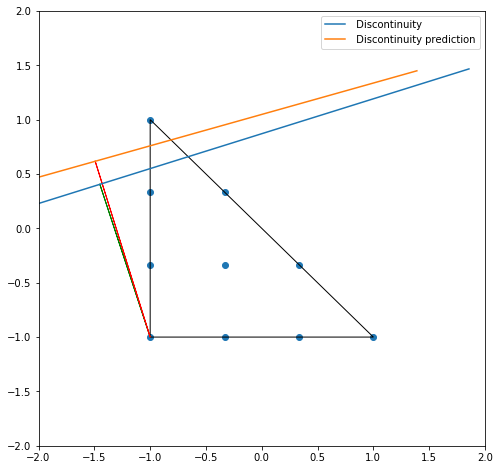

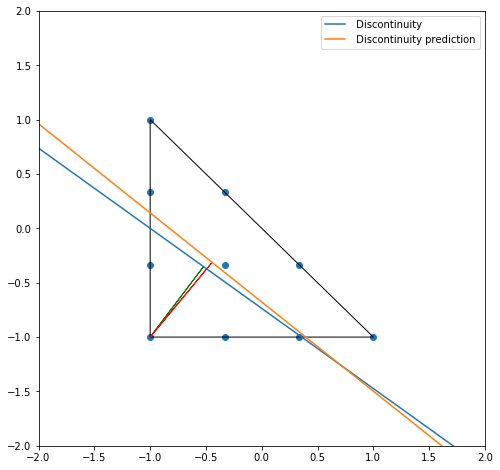

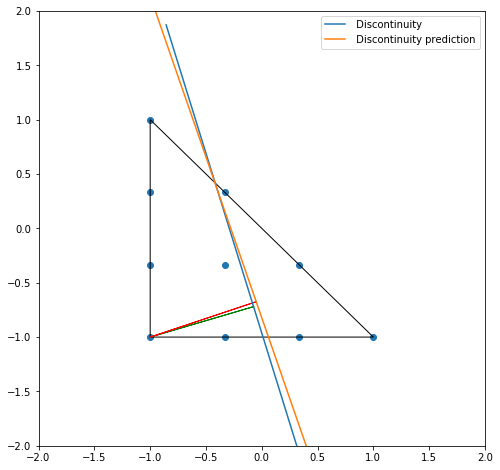

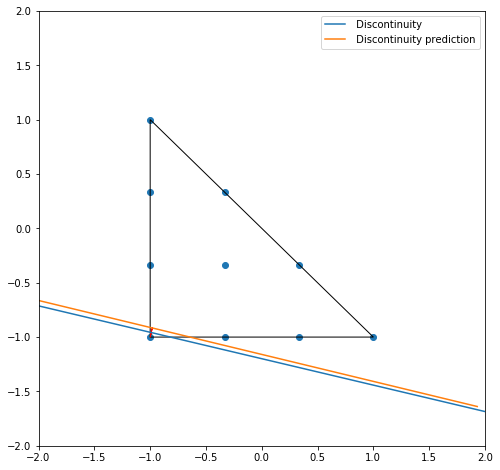

...

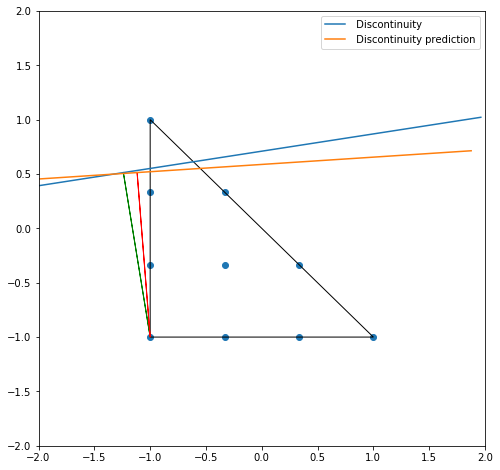

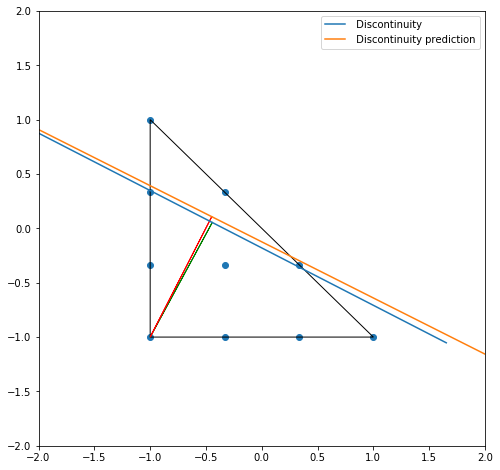

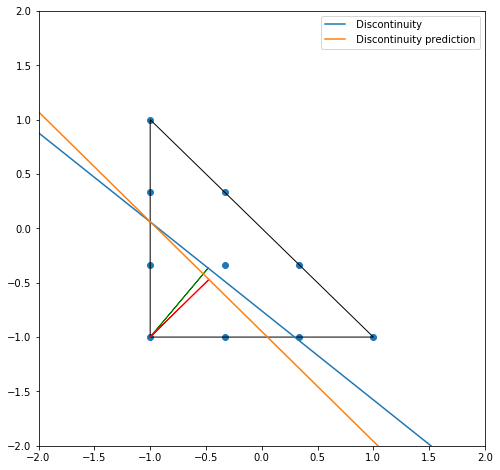

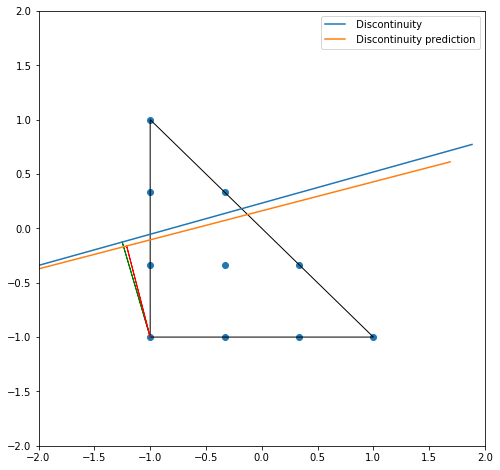

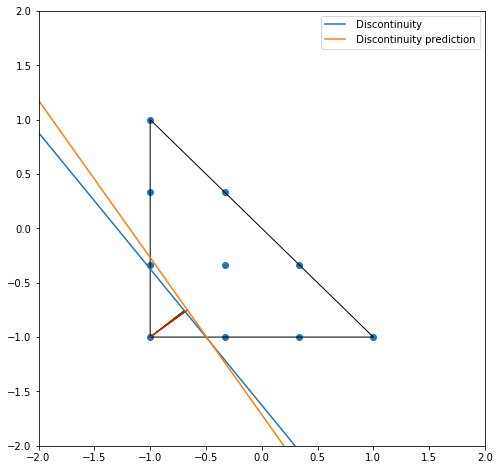

In [92]:
for ind in range(20) :
    visualisation_plot_2( [ind] ,point, ensemble_model , X_test , Y_angle_test ,Y_ortho_test)

In [94]:
Y = ensemble_model.predict(X_test , verbose = 0 )

error = Y_angle_test - Y[0][:,0]
print((Y[0][:,0]).shape)
indice_error = np.where(error>1)[0]

error_2 = compute_error(Y[0][:,0] , Y_angle_test)
indice_error_2 = np.where(error_2>0.2)[0]
print(indice_error_2.shape)

(2328,)
(99,)


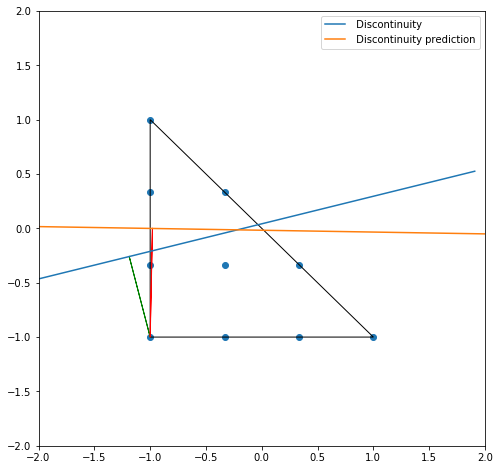

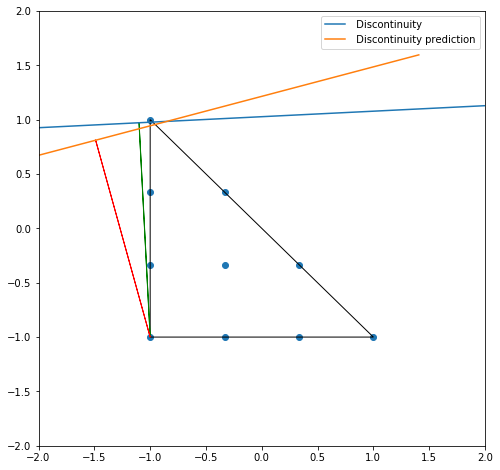

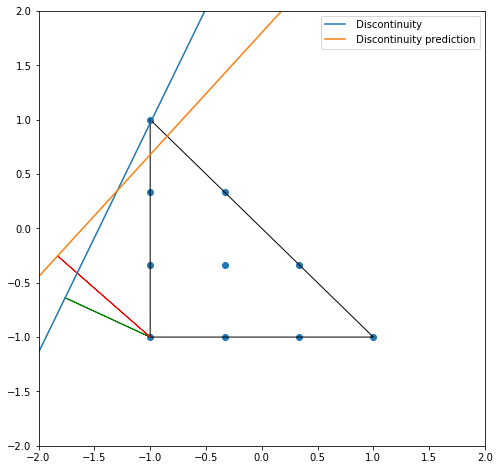

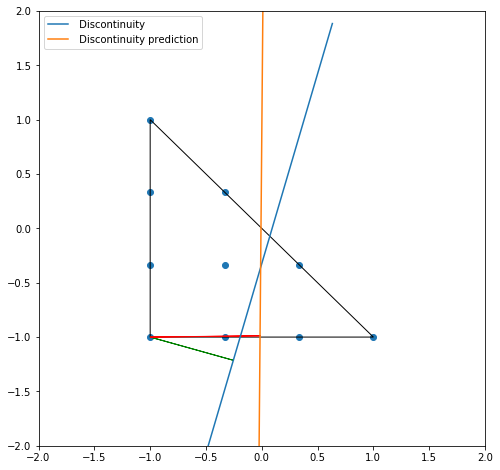

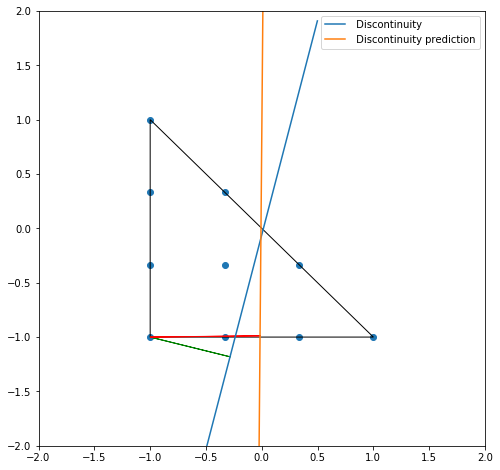

...

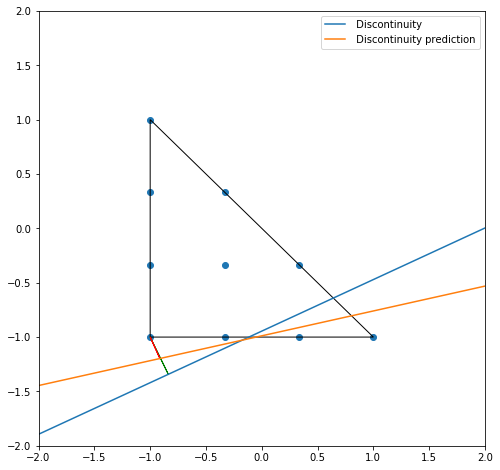

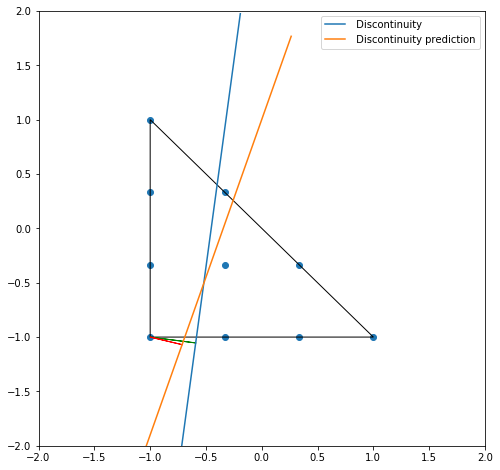

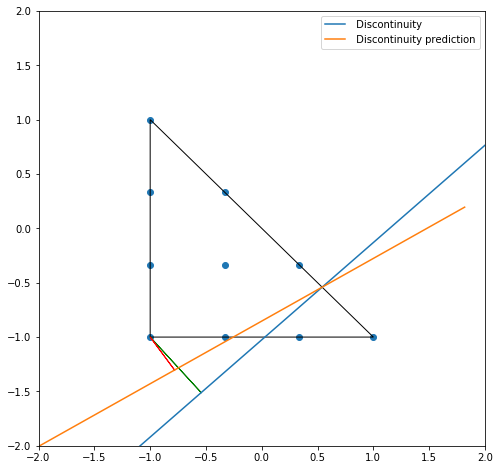

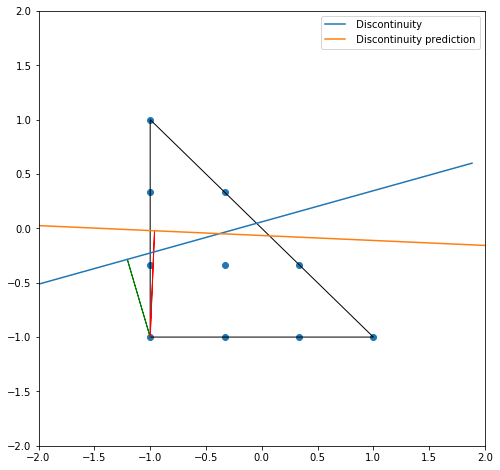

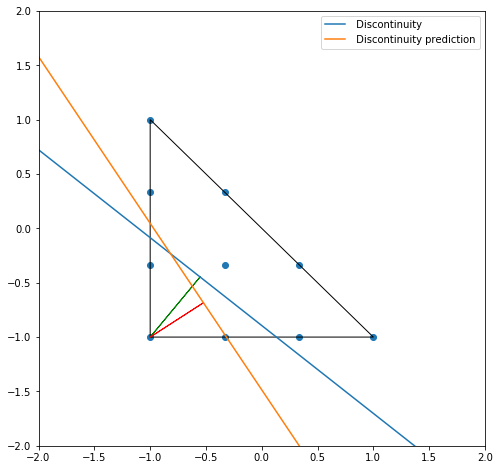

In [93]:
for ind in indice_error_2 :
    visualisation_plot_2( [ind] ,point, ensemble_model , X_test , Y_angle_test ,Y_ortho_test)